In [1]:
! source activate snowenv



In [15]:
import os

import pandas as pd
import snowflake.connector



conn = snowflake.connector.connect(
                user='ycui',
                password='Passw0rd',
                account='yka47564.us-east-1',
                warehouse='ROBOT_WH',
                database='AYLADB'
                
                )
cur = conn.cursor()

# Execute SQL statement
a=cur.execute("select * from AYLADB.yvonne.mission_result_2 limit 6")

In [20]:
a

In [21]:
df=pd.DataFrame()
for i in a:
    print(i)
    df=df.append(pd.DataFrame(i).T)

In [152]:
import pandas as pd
df=pd.read_csv('./Downloads/All_mission_results.csv', nrows=100000)


In [6]:
df.columns

Index(['PROPERTY_NAME', 'VALUE', 'CHARGING_VALUE', 'CREATED_AT_REAL', 'LABEL',
       'NEXT_CREATED_REAL', 'DUR', 'OEM_MODEL', 'DSN', 'RUNS', 'LASTEVENT',
       'JOBSTART', 'EVENTSEQ', 'JOB', 'ENTERED_DOCK_MODE',
       'CONTACTED_CHARGING_DOCK', 'GET_CLEANING_STATISTICS', 'RUNTIMECYCLE',
       'RUNTIMECUMULATIVE', 'JOBEND', 'RUNTIME', 'TIME_TO_DOCK', 'PAUSE',
       'FIRSTEVENT', '_BATCH_ID_', '_BATCH_LAST_RUN_'],
      dtype='object')

In [153]:
df[df['DSN']=='AC000W006736002']

,PROPERTY_NAME,VALUE,CHARGING_VALUE,CREATED_AT_REAL,LABEL,NEXT_CREATED_REAL,DUR,OEM_MODEL,DSN,RUNS,...,GET_CLEANING_STATISTICS,RUNTIMECYCLE,RUNTIMECUMULATIVE,JOBEND,RUNTIME,TIME_TO_DOCK,PAUSE,FIRSTEVENT,_BATCH_ID_,_BATCH_LAST_RUN_


In [119]:
import csv

import pandas as pd
import numpy as np

chunk_list=[]
for chunk in pd.read_csv('./Downloads/All_mission_results.csv', chunksize=200000):
    chunk=chunk[[ 'CREATED_AT_REAL', 
        'OEM_MODEL', 'DSN', 'RUNS', 'LASTEVENT',
       'JOBSTART', 'JOB',  'ENTERED_DOCK_MODE',
       'CONTACTED_CHARGING_DOCK', 'GET_CLEANING_STATISTICS', 'RUNTIMECYCLE',
       'RUNTIMECUMULATIVE',  'TIME_TO_DOCK', 'PAUSE',
       'FIRSTEVENT','EVENTSEQ']]
    #chunk=clean(chunk)
    chunk=chunk[chunk['OEM_MODEL'].isin(['RV1000','RV1000A'])]
    chunk['errors']=chunk['EVENTSEQ'].apply(lambda x:str(x).split(',').count('GET_Error_Code'))
    chunk['ENTERED_DOCK_MODE']=pd.to_datetime(chunk['ENTERED_DOCK_MODE'])
    chunk['CONTACTED_CHARGING_DOCK']=pd.to_datetime(chunk['CONTACTED_CHARGING_DOCK'])
    chunk['GET_CLEANING_STATISTICS']=pd.to_datetime(chunk['GET_CLEANING_STATISTICS'])
    chunk['RUNTIMECYCLE']=pd.to_datetime(chunk['RUNTIMECYCLE'])
    chunk['RUNTIMECUMULATIVE']=pd.to_datetime(chunk['RUNTIMECUMULATIVE'])
    
    chunk['JOBEND']=chunk[['ENTERED_DOCK_MODE','CONTACTED_CHARGING_DOCK', 'GET_CLEANING_STATISTICS', 'RUNTIMECYCLE',
    'RUNTIMECUMULATIVE']].min(axis=1)
    chunk=chunk.drop(['EVENTSEQ','ENTERED_DOCK_MODE',
       'CONTACTED_CHARGING_DOCK', 'GET_CLEANING_STATISTICS', 'RUNTIMECYCLE',
       'RUNTIMECUMULATIVE'],axis=1)
    
    chunk_list.append(chunk)

final_df = pd.concat(chunk_list)

In [120]:
final_df=final_df.sort_values(['OEM_MODEL','DSN','CREATED_AT_REAL'])

In [96]:
final_df['CREATED_AT_REAL'].min()

'2019-07-15 20:32:16'

In [97]:
final_df.columns

Index(['CREATED_AT_REAL', 'OEM_MODEL', 'DSN', 'RUNS', 'LASTEVENT', 'JOBSTART',
       'JOB', 'TIME_TO_DOCK', 'PAUSE', 'FIRSTEVENT', 'errors', 'JOBEND'],
      dtype='object')

In [122]:
final_df.head()

,CREATED_AT_REAL,OEM_MODEL,DSN,RUNS,LASTEVENT,JOBSTART,JOB,TIME_TO_DOCK,PAUSE,FIRSTEVENT,errors,JOBEND
15153768,2020-01-15 07:47:29,RV1000,AC000W006736002,0.0,Entered Paused Mode,2020-01-15 07:47:29,0.0,NaN,1.0,2020-01-15 07:47:29,0,NaT
40911822,2020-01-15 07:49:49,RV1000,AC000W006736002,1.0,Entered Paused Mode,2020-01-15 07:49:49,0.0,NaN,30.0,2020-01-15 07:47:29,1,NaT
57622385,2020-01-15 08:21:07,RV1000,AC000W006736002,2.0,Entered Paused Mode,2020-01-15 08:21:07,0.0,NaN,0.0,2020-01-15 07:47:29,0,2020-01-15 08:22:48
37539779,2020-01-15 08:22:59,RV1000,AC000W006736002,3.0,Entered Paused Mode,2020-01-15 08:22:59,0.0,NaN,0.0,2020-01-15 07:47:29,0,2020-01-15 08:23:00
10625638,2020-01-15 08:25:29,RV1000,AC000W006736002,4.0,Entered Paused Mode,2020-01-15 08:25:29,0.0,NaN,11.0,2020-01-15 07:47:29,0,2020-01-15 08:27:17


In [123]:
final_df['CREATED_AT_REAL']=pd.to_datetime(final_df['CREATED_AT_REAL'])
final_df['FIRSTEVENT']=pd.to_datetime(final_df['FIRSTEVENT'])

In [124]:
final_df['age']=(final_df['CREATED_AT_REAL']-final_df['FIRSTEVENT']).dt.days

In [125]:
final_df['age_bin']=(final_df['age']/14).map(int)*14

In [126]:
final_df.shape

(13312590, 14)

In [127]:
#final_df=final_df.drop(['LABEL'],axis=1)

In [128]:
final_df['JOB'].sum()

7695966.0

In [129]:
final_df['startfrom']=final_df['LASTEVENT'].shift(1)
import numpy as np
final_df.loc[(final_df['DSN']!=final_df['DSN'].shift(1)),'startfrom']=np.nan

In [130]:
final_df['weekday']=final_df['CREATED_AT_REAL'].dt.weekday
final_df['weekday']=final_df['weekday'].map({0:'Mon',1:'Tue',2:'Wed',3:'Thu',4:'Fri',5:'Sat',6:'Sun'})
final_df['hour']=final_df['CREATED_AT_REAL'].dt.hour



In [131]:
final_df['weekday']=np.where(final_df['weekday'].isin(['Sat','Sun']),'weekend','weekday')

In [55]:
final_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12699852 entries, 0 to 12699851
Data columns (total 18 columns):
CREATED_AT_REAL    datetime64[ns]
OEM_MODEL          object
DSN                object
RUNS               float64
LASTEVENT          object
JOBSTART           object
JOB                float64
JOBEND             object
RUNTIME            float64
TIME_TO_DOCK       float64
PAUSE              float64
FIRSTEVENT         datetime64[ns]
errors             int64
age                int64
age_bin            int64
startfrom          object
weekday            int64
hour               int64
dtypes: datetime64[ns](2), float64(5), int64(5), object(6)
memory usage: 1.7+ GB


In [49]:
#final_df=final_df.reset_index(drop=True)

In [132]:
#2-10,10-16,16-22,22-2
bin_labels_5 = ['night','morning', 'afternoon', 'evening']
final_df['day']=pd.cut(final_df['hour'],bins=[0,3, 11, 17, 23],labels=bin_labels_5)
#final_df['day']=np.where(final_df['day']=='night1','night',final_df['day'])

In [133]:
final_df.columns

Index(['CREATED_AT_REAL', 'OEM_MODEL', 'DSN', 'RUNS', 'LASTEVENT', 'JOBSTART',
       'JOB', 'TIME_TO_DOCK', 'PAUSE', 'FIRSTEVENT', 'errors', 'JOBEND', 'age',
       'age_bin', 'startfrom', 'weekday', 'hour', 'day'],
      dtype='object')

In [134]:
final_df.shape

(13312590, 18)

In [135]:

final_df['job_end']=final_df['JOBSTART'].shift(-1)
final_df.loc[(final_df['DSN']!=final_df['DSN'].shift(-1)),'job_end']=np.nan

In [136]:
final_df['JOBEND']=pd.to_datetime(final_df['JOBEND'])
final_df['job_end']=pd.to_datetime(final_df['job_end'])
final_df['JOBSTART']=pd.to_datetime(final_df['JOBSTART'])



In [137]:
final_df['RUNTIME']=(final_df[['JOBEND','job_end']].min(axis=1)-final_df['JOBSTART']).dt.total_seconds()/60

In [138]:
final_df.describe()

,RUNS,JOB,TIME_TO_DOCK,PAUSE,errors,age,age_bin,hour,RUNTIME
count,1.331259e+07,1.331259e+07,9.685158e+06,7.603315e+06,1.331259e+07,1.331259e+07,1.331259e+07,1.331259e+07,1.330938e+07
mean,1.078228e+02,5.780968e-01,6.803237e+01,1.663086e+02,3.257793e-01,4.966085e+01,4.375667e+01,1.471537e+01,5.761030e+01
std,1.145598e+02,4.938632e-01,1.001279e+03,2.252408e+03,6.137976e-01,4.117364e+01,4.068092e+01,6.329574e+00,7.395238e+02
min,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,2.900000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.400000e+01,1.400000e+01,1.300000e+01,6.583333e+00
50%,7.300000e+01,1.000000e+00,1.000000e+00,1.000000e+00,0.000000e+00,4.100000e+01,2.800000e+01,1.600000e+01,2.795000e+01
75%,1.500000e+02,1.000000e+00,3.000000e+00,9.000000e+00,1.000000e+00,7.900000e+01,7.000000e+01,1.900000e+01,4.400000e+01
max,2.864000e+03,1.000000e+00,2.377680e+05,2.561750e+05,2.200000e+01,2.380000e+02,2.380000e+02,2.300000e+01,2.704132e+05


In [139]:
from scipy import stats
z = np.abs(stats.zscore(final_df[[ 'RUNTIME', 'TIME_TO_DOCK', 'PAUSE','errors']].fillna(0)))
final_df=final_df[(z < 3).all(axis=1)]

In [144]:
def fun(data):
    
    end=data.groupby('LASTEVENT').size()
    end.index= ['end'+i for i in end.index]
    start=data.groupby('startfrom').size()
    start.index= ['start'+i for i in start.index]
    
    weekday=data.groupby('weekday').size()
    day=data.groupby(['day']).size()
    
    dock=data['TIME_TO_DOCK'].dropna().describe()
    pause=data['PAUSE'].dropna().describe()
    errors=data['errors'].sum()
    
    dock.index= [i+'time to dock' for i in dock.index]
    
    pause.index= [i+'pause time' for i in pause.index]
    sw=data.groupby(['weekday']).apply(lambda x:x['JOB'].sum()/len(x))
    sd=data.groupby(['day']).apply(lambda x:x['JOB'].sum()/len(x))
    
    sw.index= [i+'successrate' for i in sw.index]
    sd.index= [i+'successrate' for i in sd.index]
    
    
    
    
    s=data['JOB'].sum()/data['RUNS'].nunique()
    s1=data[data['RUNTIME']>1]['JOB'].sum()/len(data[data['RUNTIME']>1])
    s15=data[data['RUNTIME']>15]['JOB'].sum()/len(data[data['RUNTIME']>15])
    a=pd.DataFrame([data['RUNS'].nunique(),data['RUNS'].max()+1,data['RUNTIME'].max(),data['RUNTIME'].min(),data['RUNTIME'].mean(),data['RUNTIME'].median(),data['RUNTIME'].sum(),errors,s,s1,s15,len(data[data['RUNTIME']<=1]),len(data[(data['RUNTIME']<=15)&(data['RUNTIME']>1)])],
                 index=['jobs','cumjobs','max_runtime','min_runtime','mean_runtime','median_runtime','totalruntime','sum_error','successrate','realrate','longrate','less_1_min_runs','shortruns'])
    return pd.concat([end,start,a,weekday,day,dock.T,pause.T,sw.T,sd.T]).T

In [70]:
final_df.columns

Index(['CREATED_AT_REAL', 'OEM_MODEL', 'DSN', 'RUNS', 'LASTEVENT', 'JOBSTART',
       'JOB', 'JOBEND', 'RUNTIME', 'TIME_TO_DOCK', 'PAUSE', 'FIRSTEVENT',
       'errors', 'age', 'age_bin', 'startfrom', 'weekday', 'hour', 'day'],
      dtype='object')

In [148]:
final_df['RUNTIME'].max()

2275.85

In [158]:
final_df.to_csv('all_mission_results_rv.csv',index=False)

In [160]:
import os
os.system('say "your program has finished"')

0

In [161]:
final_df.groupby(['OEM_MODEL','DSN','age_bin']).apply(fun).reset_index().to_csv('age_rv_cluster_biweek.csv',index=False)

/Users/ycui/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:19: RuntimeWarning: invalid value encountered in double_scalars
/Users/ycui/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:28: RuntimeWarning: invalid value encountered in double_scalars
/Users/ycui/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:29: RuntimeWarning: invalid value encountered in double_scalars


In [162]:
os.system('say "your program has finished"')

0

In [563]:
data=pd.read_csv('age_rv_cluster_biweek.csv')

In [3]:
import pandas as pd
data=pd.read_csv('age_rv_cluster_biweek_rolling.csv')

In [730]:
data.columns[:60]

Index(['OEM_MODEL', 'DSN', 'age_bin', 'endContacted Charging Dock',
       'endEntered Paused Mode', 'startContacted Charging Dock',
       'startEntered Paused Mode', 'date', 'jobs', 'cumjobs', 'max_runtime',
       'min_runtime', 'mean_runtime', 'median_runtime', 'totalruntime',
       'sum_error', 'successrate', 'realrate', 'longrate', 'less_1_min_runs',
       'shortruns', 'weekday', 'night', 'morning', 'afternoon', 'evening',
       'counttime to dock', 'meantime to dock', 'stdtime to dock',
       'mintime to dock', '25%time to dock', '50%time to dock',
       '75%time to dock', 'maxtime to dock', 'countpause time',
       'meanpause time', 'stdpause time', 'minpause time', '25%pause time',
       '50%pause time', '75%pause time', 'maxpause time', 'weekdaysuccessrate',
       'nightsuccessrate', 'morningsuccessrate', 'afternoonsuccessrate',
       'eveningsuccessrate', 'weekend', 'weekendsuccessrate', 'successjobs',
       'realsuccessjobs', 'jobs_cum', 'endContacted Charging Doc

In [4]:
data=data.drop(['endContacted Charging Dock_rolling4',
       'endEntered Paused Mode_rolling4',
       'startContacted Charging Dock_rolling4',
       'startEntered Paused Mode_rolling4', 'jobs_rolling4',
       'max_runtime_rolling4','min_runtime_rolling4', 'mean_runtime_rolling4',
       'median_runtime_rolling4', 'totalruntime_rolling4',
       'sum_error_rolling4', 'successrate_rolling4', 'realrate_rolling4',
       'longrate_rolling4', 'less_1_min_runs_rolling4', 'shortruns_rolling4',
       'weekday_rolling4', 'night_rolling4', 'morning_rolling4',
       'afternoon_rolling4', 'evening_rolling4', 'counttime to dock_rolling4',
       'meantime to dock_rolling4', 'stdtime to dock_rolling4',
       'mintime to dock_rolling4', '25%time to dock_rolling4',
       '50%time to dock_rolling4', '75%time to dock_rolling4',
       'maxtime to dock_rolling4', 'countpause time_rolling4',
       'meanpause time_rolling4', 'stdpause time_rolling4',
       'minpause time_rolling4', '25%pause time_rolling4',
       '50%pause time_rolling4', '75%pause time_rolling4',
       'maxpause time_rolling4', 'weekdaysuccessrate_rolling4',
       'nightsuccessrate_rolling4', 'morningsuccessrate_rolling4',
       'afternoonsuccessrate_rolling4', 'eveningsuccessrate_rolling4',
       'weekend_rolling4', 'weekendsuccessrate_rolling4'],axis=1)

In [5]:
data.columns[60:120]

Index(['weekday_cum', 'night_cum', 'morning_cum', 'afternoon_cum',
       'evening_cum', 'counttime to dock_cum', 'countpause time_cum',
       'weekend_cum', 'successjobs_cum', 'realsuccessjobs_cum',
       'endContacted Charging Dock_rolling2',
       'endEntered Paused Mode_rolling2',
       'startContacted Charging Dock_rolling2',
       'startEntered Paused Mode_rolling2', 'jobs_rolling2',
       'max_runtime_rolling2', 'min_runtime_rolling2', 'mean_runtime_rolling2',
       'median_runtime_rolling2', 'totalruntime_rolling2',
       'sum_error_rolling2', 'successrate_rolling2', 'realrate_rolling2',
       'longrate_rolling2', 'less_1_min_runs_rolling2', 'shortruns_rolling2',
       'weekday_rolling2', 'night_rolling2', 'morning_rolling2',
       'afternoon_rolling2', 'evening_rolling2', 'counttime to dock_rolling2',
       'meantime to dock_rolling2', 'stdtime to dock_rolling2',
       'mintime to dock_rolling2', '25%time to dock_rolling2',
       '50%time to dock_rolling2', '75%t

In [6]:
data.columns[120:]

Index([], dtype='object')

In [7]:
for i in ['endContacted Charging Dock_cum',
       'endEntered Paused Mode_cum', 'startContacted Charging Dock_cum',
       'startEntered Paused Mode_cum', 'sum_error_cum', 'less_1_min_runs_cum',
       'totalruntime_cum', 'shortruns_cum','weekday_cum', 'night_cum', 'morning_cum', 'afternoon_cum',
       'evening_cum', 'counttime to dock_cum', 'countpause time_cum',
       'weekend_cum', 'successjobs_cum', 'realsuccessjobs_cum']:
    data[i]=data[i]/data['jobs_cum']

In [8]:
data['gap_cum']=data['gap_cum']/data['age_bin']
data['unique_date']=data['unique_date']/14

In [9]:
data.columns

Index(['OEM_MODEL', 'DSN', 'age_bin', 'endContacted Charging Dock',
       'endEntered Paused Mode', 'startContacted Charging Dock',
       'startEntered Paused Mode', 'date', 'jobs', 'cumjobs',
       ...
       'nightsuccessrate_rolling2', 'morningsuccessrate_rolling2',
       'afternoonsuccessrate_rolling2', 'eveningsuccessrate_rolling2',
       'weekend_rolling2', 'weekendsuccessrate_rolling2', 'gap', 'gap_cum',
       'jobs_gap', 'unique_date'],
      dtype='object', length=118)

In [10]:
data=data.drop(['cumjobs'],axis=1)

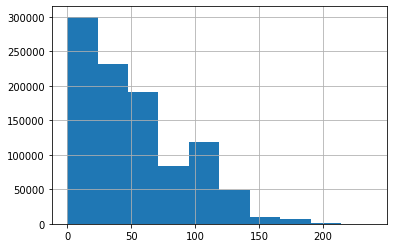

In [566]:
data['age_bin'].hist()

In [171]:
! pip install ml_insights

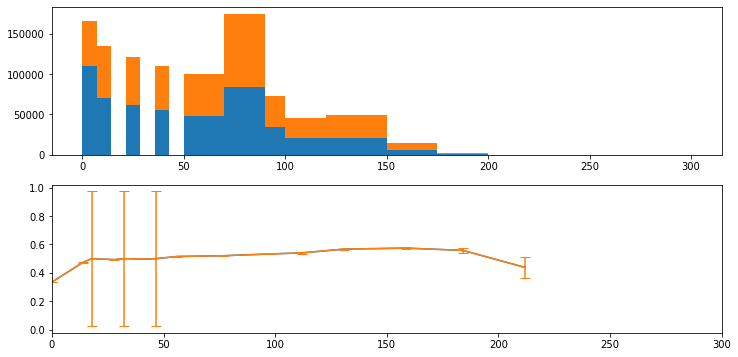

In [338]:
import ml_insights as mli
bins_1 = np.linspace(0,50,8)
bins_2 = np.array([50,70,90,100,120,150, 175,200, 300])
bins_final = np.unique(np.concatenate((bins_1, bins_2)))
mli.histogram_pair(data.age_bin, data.successrate>0.45, bins=bins_final);

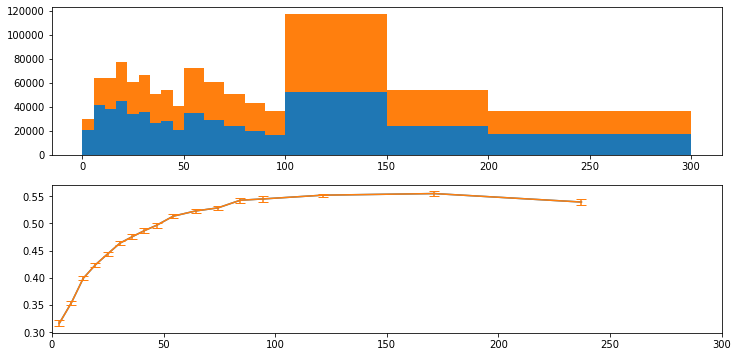

In [331]:
bins_1 = np.linspace(0,50,10)
bins_2 = np.array([50,60,70,80,90,100,150, 200, 300])
bins_final = np.unique(np.concatenate((bins_1, bins_2)))
mli.histogram_pair(data.jobs_cum, data.successrate>0.45, bins=bins_final);

In [628]:
data.columns

Index(['OEM_MODEL', 'DSN', 'age_bin', 'endContacted Charging Dock',
       'endEntered Paused Mode', 'startContacted Charging Dock',
       'startEntered Paused Mode', 'date', 'jobs', 'max_runtime',
       ...
       'nightsuccessrate_rolling4', 'morningsuccessrate_rolling4',
       'afternoonsuccessrate_rolling4', 'eveningsuccessrate_rolling4',
       'weekend_rolling4', 'weekendsuccessrate_rolling4', 'gap', 'gap_cum',
       'jobs_gap', 'unique_date'],
      dtype='object', length=161)

In [567]:

# for i in ['endContacted Charging Dock',
#        'endEntered Paused Mode', 'startContacted Charging Dock',
#        'startEntered Paused Mode',  'less_1_min_runs', 'shortruns',
#        'weekday', 'night', 'morning', 'afternoon', 'evening',
#        'counttime to dock', 'countpause time',
#         'weekend']:
#     data[i]=data[i]/data['jobs']



In [11]:
data['error_per']=data['sum_error']/data['jobs']

In [12]:
data['cumdaily']=data['jobs_cum']/(data['age_bin']+14)

In [13]:
data['daily']=data['jobs']/(14)

In [14]:
data['dailyruntime']=data['totalruntime']/14

In [15]:
data['error_per_cum']=data['sum_error_cum']/data['jobs_cum']

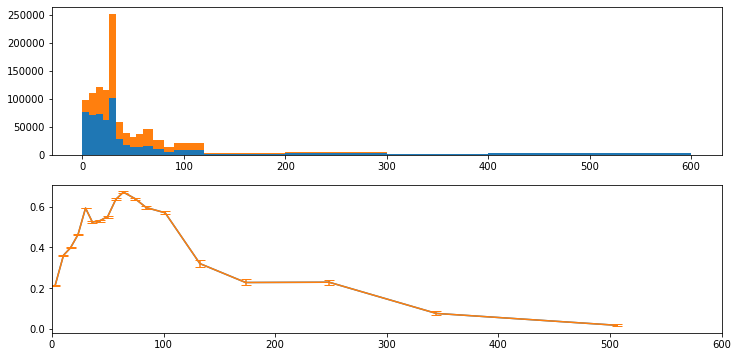

In [266]:
bins_1 = np.linspace(0,60,10)
bins_2 = np.array([60,70,80,90,120,150,200,300,400,600])
bins_final = np.unique(np.concatenate((bins_1, bins_2)))
mli.histogram_pair(data.median_runtime, data.successrate>0.45, bins=bins_final);

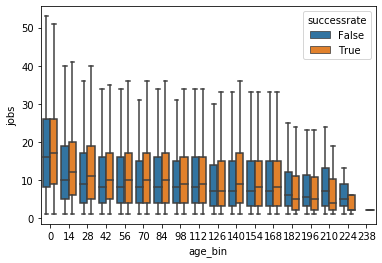

In [267]:
import seaborn as sns
sns.boxplot(x=data['age_bin'],y=data['jobs'],hue=data.successrate>0.45,showfliers=False)

In [502]:
mask = data.isnull()
unique_rows, counts = np.unique(mask, axis=0,return_counts=True)
print(unique_rows.shape) # 6 patterns, we will train 6 models
for i in range(len(counts)):
    print(unique_rows[i],counts[i])

(2828, 50)
[False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False] 74782
[False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False  True
  True False] 2842
[False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False  True False
 False False] 4764
[False False False False False False False False False 

 False False] 12
[False False False False False  True False False False False False False
 False False False False False False  True False False  True False False
 False False False False  True False False False False False False False
 False False False False False False  True  True  True False  True False
 False False] 88
[False False False False False  True False False False False False False
 False False False False False False  True False False  True False False
 False False False False  True False False False False False False False
 False False False False False False  True  True  True  True False False
 False False] 158
[False False False False False  True False False False False False False
 False False False False False False  True False False  True False False
 False False False False  True False False False False False False False
 False False False False False False  True  True  True  True  True False
 False False] 11
[False False False False False  True False False False 

 False False] 3
[False False False False  True  True  True False False False False False
 False False False False False  True  True False False  True False False
 False False False  True  True  True  True  True  True  True False  True
  True  True  True  True  True  True  True  True  True False  True False
 False False] 26
[False False False False  True  True  True False False False False False
 False False False False False  True  True False False  True False False
 False False False  True  True  True  True  True  True  True False  True
  True  True  True  True  True  True  True  True  True  True False False
 False False] 33
[False False False False  True  True  True False False False False False
 False False False False False  True  True False False  True False False
 False False False  True  True  True  True  True  True  True False  True
  True  True  True  True  True  True  True  True  True  True  True False
 False False] 7
[False False False  True False False False False False Fal

In [639]:
data.columns

Index(['OEM_MODEL', 'DSN', 'age_bin', 'endContacted Charging Dock',
       'endEntered Paused Mode', 'startContacted Charging Dock',
       'startEntered Paused Mode', 'date', 'jobs', 'max_runtime',
       ...
       'weekendsuccessrate_rolling4', 'gap', 'gap_cum', 'jobs_gap',
       'unique_date', 'error_per', 'cumdaily', 'daily', 'dailyruntime',
       'error_per_cum'],
      dtype='object', length=166)

In [581]:
# data[['age_bin', 'endContacted Charging Dock',
#        'endEntered Paused Mode', 'startContacted Charging Dock',
#        'startEntered Paused Mode', 'jobs', 'cumjobs', 'max_runtime', 'min_runtime',
#        'mean_runtime', 'median_runtime', 'totalruntime', 'sum_error',
#        'successrate', 'realrate', 'longrate', 'less_1_min_runs', 'shortruns',
#        'weekday', 'night', 'morning', 'afternoon', 'evening',
#        'counttime to dock', 'meantime to dock', '50%time to dock',
#       'maxtime to dock', 'countpause time',
#        'meanpause time',
#        '50%pause time',  'maxpause time', 'weekdaysuccessrate',
#        'nightsuccessrate', 'morningsuccessrate', 'afternoonsuccessrate',
#        'eveningsuccessrate', 'weekend', 'weekendsuccessrate', 'error_per','cumdaily', 'daily', 'dailyruntime']]=data[['age_bin', 'endContacted Charging Dock',
#        'endEntered Paused Mode', 'startContacted Charging Dock',
#        'startEntered Paused Mode', 'jobs',  'cumjobs','max_runtime', 'min_runtime',
#        'mean_runtime', 'median_runtime', 'totalruntime', 'sum_error',
#        'successrate', 'realrate', 'longrate', 'less_1_min_runs', 'shortruns',
#        'weekday', 'night', 'morning', 'afternoon', 'evening',
#        'counttime to dock', 'meantime to dock', '50%time to dock',
#       'maxtime to dock', 'countpause time',
#        'meanpause time',
#        '50%pause time',  'maxpause time', 'weekdaysuccessrate',
#        'nightsuccessrate', 'morningsuccessrate', 'afternoonsuccessrate',
#        'eveningsuccessrate', 'weekend', 'weekendsuccessrate', 'error_per','cumdaily', 'daily', 'dailyruntime']].fillna(0)

In [51]:
data=data.fillna(0)

In [37]:
data.columns[3:63]

Index(['endContacted Charging Dock', 'endEntered Paused Mode',
       'startContacted Charging Dock', 'startEntered Paused Mode', 'date',
       'jobs', 'max_runtime', 'min_runtime', 'mean_runtime', 'median_runtime',
       'totalruntime', 'sum_error', 'successrate', 'realrate', 'longrate',
       'less_1_min_runs', 'shortruns', 'weekday', 'night', 'morning',
       'afternoon', 'evening', 'counttime to dock', 'meantime to dock',
       'stdtime to dock', 'mintime to dock', '25%time to dock',
       '50%time to dock', '75%time to dock', 'maxtime to dock',
       'countpause time', 'meanpause time', 'stdpause time', 'minpause time',
       '25%pause time', '50%pause time', '75%pause time', 'maxpause time',
       'weekdaysuccessrate', 'nightsuccessrate', 'morningsuccessrate',
       'afternoonsuccessrate', 'eveningsuccessrate', 'weekend',
       'weekendsuccessrate', 'successjobs', 'realsuccessjobs', 'jobs_cum',
       'endContacted Charging Dock_cum', 'endEntered Paused Mode_cum',
    

In [38]:
data.columns[63:]

Index(['evening_cum', 'counttime to dock_cum', 'countpause time_cum',
       'weekend_cum', 'successjobs_cum', 'realsuccessjobs_cum',
       'endContacted Charging Dock_rolling2',
       'endEntered Paused Mode_rolling2',
       'startContacted Charging Dock_rolling2',
       'startEntered Paused Mode_rolling2', 'jobs_rolling2',
       'max_runtime_rolling2', 'min_runtime_rolling2', 'mean_runtime_rolling2',
       'median_runtime_rolling2', 'totalruntime_rolling2',
       'sum_error_rolling2', 'successrate_rolling2', 'realrate_rolling2',
       'longrate_rolling2', 'less_1_min_runs_rolling2', 'shortruns_rolling2',
       'weekday_rolling2', 'night_rolling2', 'morning_rolling2',
       'afternoon_rolling2', 'evening_rolling2', 'counttime to dock_rolling2',
       'meantime to dock_rolling2', 'stdtime to dock_rolling2',
       'mintime to dock_rolling2', '25%time to dock_rolling2',
       '50%time to dock_rolling2', '75%time to dock_rolling2',
       'maxtime to dock_rolling2', 'countpau

In [39]:
from scipy import stats
skewlist=[]
for i in ['age_bin', 'endContacted Charging Dock',
       'endEntered Paused Mode', 'startContacted Charging Dock',
       'startEntered Paused Mode', 'jobs', 'max_runtime', 'min_runtime',
       'mean_runtime', 'median_runtime', 'totalruntime', 'sum_error',
       'successrate', 'realrate', 'longrate', 'less_1_min_runs', 'shortruns',
       'weekday', 'night', 'morning', 'afternoon', 'evening',
       'counttime to dock', 'meantime to dock', '50%time to dock',
      'maxtime to dock', 'countpause time',
       'meanpause time',
       '50%pause time',  'maxpause time', 'weekdaysuccessrate',
       'nightsuccessrate', 'morningsuccessrate', 'afternoonsuccessrate',
       'eveningsuccessrate', 'weekend', 'weekendsuccessrate', 'error_per']:
    
    if stats.skew(data[i])>1:
        skewlist.append(i)
    

In [40]:
# skewlist=['age_bin', 'endContacted Charging Dock',
#        'endEntered Paused Mode', 'startContacted Charging Dock',
#        'startEntered Paused Mode', 'jobs',  'cumjobs', 'min_runtime',
#        'mean_runtime', 'median_runtime', 'totalruntime', 'sum_error',
#        'successrate', 'realrate', 'longrate', 'less_1_min_runs', 'shortruns',
#        'weekday', 'night', 'morning', 'afternoon', 'evening',
#        'counttime to dock', 'meantime to dock', '50%time to dock',
#       'maxtime to dock', 'countpause time',
#        'meanpause time',
#        '50%pause time',  'maxpause time', 'weekdaysuccessrate',
#        'nightsuccessrate', 'morningsuccessrate', 'afternoonsuccessrate',
#        'eveningsuccessrate', 'weekend', 'weekendsuccessrate', 'error_per','cumdaily', 'daily', 'dailyruntime']

In [41]:
skewlist=list(data.columns[2:])
skewlist.remove('date')

In [269]:
skewlist=['age_bin', 'endContacted Charging Dock', 'endEntered Paused Mode', 'startContacted Charging Dock', 'startEntered Paused Mode', 'jobs', 'max_runtime', 'min_runtime', 'mean_runtime', 'median_runtime', 'totalruntime', 'sum_error', 'successrate', 'realrate', 'longrate', 'less_1_min_runs', 'shortruns', 'weekday', 'night', 'morning', 'afternoon', 'evening', 'counttime to dock', 'meantime to dock', 'stdtime to dock', 'mintime to dock', '25%time to dock', '50%time to dock', '75%time to dock', 'maxtime to dock', 'countpause time', 'meanpause time', 'stdpause time', 'minpause time', '25%pause time', '50%pause time', '75%pause time', 'maxpause time', 'weekdaysuccessrate', 'nightsuccessrate', 'morningsuccessrate', 'afternoonsuccessrate', 'eveningsuccessrate', 'weekend', 'weekendsuccessrate', 'successjobs', 'realsuccessjobs', 'jobs_cum', 'endContacted Charging Dock_cum', 'endEntered Paused Mode_cum', 'startContacted Charging Dock_cum', 'startEntered Paused Mode_cum', 'sum_error_cum', 'less_1_min_runs_cum', 'totalruntime_cum', 'shortruns_cum', 'weekday_cum', 'night_cum', 'morning_cum', 'afternoon_cum', 'evening_cum', 'counttime to dock_cum', 'countpause time_cum', 'weekend_cum', 'successjobs_cum', 'realsuccessjobs_cum',
          'gap', 'gap_cum', 'jobs_gap', 'unique_date', 'error_per', 'cumdaily', 'daily', 'dailyruntime', 'error_per_cum']

In [42]:
#skewlistsig=[i+'_sig' for i in skewlist]

In [43]:
# z = np.abs(stats.zscore(data[ ['min_runtime',
#        'mean_runtime', 'median_runtime', 'totalruntime', 'sum_error',
#        'less_1_min_runs', 'shortruns',
      
#        'counttime to dock', 'meantime to dock', '50%time to dock',
#       'maxtime to dock', 'countpause time',
#        'meanpause time',
#        '50%pause time',  'maxpause time']]))
# data=data[(z < 4).all(axis=1)]

In [44]:
data.shape

(990478, 122)

In [45]:
#data=data[data['age_bin']!=0]

In [52]:
from sklearn.preprocessing import QuantileTransformer

qt_trans = QuantileTransformer(n_quantiles=10000, random_state=2)
qt_trans.fit(data[skewlist].values[:792382])
qt = pd.DataFrame(qt_trans.transform(data[skewlist]))
qt.columns = data[skewlist].columns
qt[['DSN','OEM_MODEL']]=data[['DSN','OEM_MODEL']]

In [53]:
data.shape

(990478, 122)

In [54]:
def sigmoid(x):
    e = np.exp(1)
    y = 1/(1+e**(-x))
    return y
## data[skewlistsig] = sigmoid(data[skewlist])


In [55]:
from sklearn.preprocessing import MinMaxScaler

from sklearn.preprocessing import MaxAbsScaler
import pickle

In [56]:
import tensorflow as tf
from tensorflow import keras
tf.compat.v1.disable_eager_execution()
tf.__version__, keras.__version__

('2.1.0', '2.2.4-tf')

In [256]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
import shap
import xgboost
from xgboost import XGBClassifier
#train,test = train_test_split(data, test_size=0.20, random_state=None)

train = qt[:792382]
test = qt[792382:]
train.shape, test.shape

((792382, 121), (198096, 121))

In [58]:
train.columns

Index(['age_bin', 'endContacted Charging Dock', 'endEntered Paused Mode',
       'startContacted Charging Dock', 'startEntered Paused Mode', 'jobs',
       'max_runtime', 'min_runtime', 'mean_runtime', 'median_runtime',
       ...
       'gap_cum', 'jobs_gap', 'unique_date', 'error_per', 'cumdaily', 'daily',
       'dailyruntime', 'error_per_cum', 'DSN', 'OEM_MODEL'],
      dtype='object', length=121)

In [271]:
from tensorflow.keras import layers
from tensorflow.keras import backend as K
from tensorflow.keras.models import Model

input_shape = (train[skewlist].shape[1],)
latent_dim = 1  # Dimensionality of the latent space: a line
dense_width = 1024

input_x = keras.Input(shape=input_shape)

x = layers.Dense(dense_width, activation='relu')(input_x)
x = layers.Dense(dense_width, activation='relu')(x)
x = layers.Dense(dense_width, activation='relu')(x)
x = layers.Dense(dense_width, activation='sigmoid')(x)

z_mean = layers.Dense(latent_dim)(x)
z_log_var = layers.Dense(latent_dim)(x)

encoder = Model(input_x, z_mean)

In [272]:
def sampling(args):
    z_mean, z_log_var = args
    epsilon = K.random_normal(shape=(K.shape(z_mean)[0], latent_dim),
                              mean=0., stddev=1.)
    return z_mean + K.exp(z_log_var) * epsilon

z = layers.Lambda(sampling)([z_mean, z_log_var])

In [273]:
# This is the input where we will feed `z`.
decoder_input = layers.Input(K.int_shape(z)[1:])

# Upsample to the correct number of units
x = layers.Dense(dense_width,activation='relu')(decoder_input)
x = layers.Dense(dense_width,activation='relu')(x)
x = layers.Dense(dense_width,activation='relu')(x)
x = layers.Dense(dense_width,activation='sigmoid')(x)

x = layers.Dense(input_shape[0])(x)

# This is our decoder model.
decoder = Model(decoder_input, x)

# We then apply it to `z` to recover the decoded `z`.
z_decoded = decoder(z)


In [274]:
class CustomVariationalLayer(keras.layers.Layer):

    def vae_loss(self, x, z_decoded):
        xent_loss = keras.metrics.mse(x, z_decoded)
        kl_loss = -5e-4 * K.mean(
            1 + z_log_var - K.square(z_mean) - K.exp(z_log_var), axis=-1)
        return K.mean(xent_loss + kl_loss)

    def call(self, inputs):
        x = inputs[0]
        z_decoded = inputs[1]
        loss = self.vae_loss(x, z_decoded)
        self.add_loss(loss, inputs=inputs)
        # We don't use this output.
        return x

# We call our custom layer on the input and the decoded output,
# to obtain the final model output.
y = CustomVariationalLayer()([input_x, z_decoded])

vae = Model(input_x, y)

In [275]:
train.shape

(792382, 121)

In [276]:
vae.compile(optimizer='adam', loss=None)

n_batch_sizes=1

history =['']*n_batch_sizes
titles  =['']*n_batch_sizes

# Train the VAE on boston housing data

for i in range(n_batch_sizes):

  # Alternate between a few epochs with large batch size (reliable decrease in 
  # loss but weak and overfitting) and lots of epochs with small batch size
  # (strong and non-overfitting but could increase loss)
    batch_size = 1024*(1-(i%2)) + 512*(i%2)
    epochs = 20*(1-(i%2)) + 50*(i%2)

    print('Batch size:', batch_size)
    titles[i] = 'Round {}, Batch size {}'.format(i+1, batch_size)

    history[i] = vae.fit(x=train[skewlist], y=None,
                       shuffle=True,
                       epochs=epochs,
                       batch_size=batch_size,
                       validation_data=(test[skewlist], None))


Batch size: 1024
Train on 792382 samples, validate on 198096 samples
Epoch 1/20
792382/792382 [==============================] - 121s 153us/sample - loss: 0.0763 - val_loss: 0.0687
Epoch 2/20
792382/792382 [==============================] - 139s 176us/sample - loss: 0.0673 - val_loss: 0.0650
Epoch 3/20
792382/792382 [==============================] - 133s 168us/sample - loss: 0.0649 - val_loss: 0.0630
Epoch 4/20
792382/792382 [==============================] - 133s 168us/sample - loss: 0.0663 - val_loss: 0.0642
Epoch 5/20
792382/792382 [==============================] - 134s 169us/sample - loss: 0.0637 - val_loss: 0.0649
Epoch 6/20
792382/792382 [==============================] - 133s 168us/sample - loss: 0.0632 - val_loss: 0.0615
Epoch 7/20
792382/792382 [==============================] - 135s 170us/sample - loss: 0.0623 - val_loss: 0.0624
Epoch 8/20
792382/792382 [==============================] - 131s 165us/sample - loss: 0.0644 - val_loss: 0.0627
Epoch 9/20
792382/792382 [=========

TypeError: 'AxesSubplot' object is not subscriptable

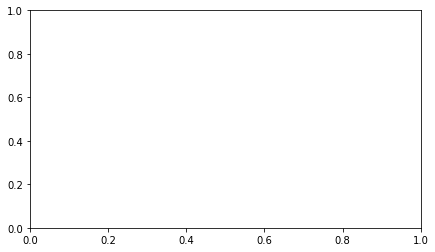

In [669]:
import matplotlib.pyplot as plt

f, ax = plt.subplots(len(history), 1, figsize=(7, len(history)*4), sharex=True)

for i in range(len(history)):

    ax[i].set_title(titles[i])
    ax[i].plot(history[i].epoch, np.log(history[i].history['val_loss']), label='Validation')
    ax[i].plot(history[i].epoch, np.log(history[i].history['loss']), label='Training')
    ax[i].set_xlabel('Epochs')
    ax[i].set_ylabel('Log loss')
    ax[i].legend()
    ax[i].grid()
    
    

In [277]:
encoded_data=encoder.predict(qt[skewlist]).flatten()
encoded_data.shape

(990478,)

In [278]:
encoded_data.max(),encoded_data.min()

(7.6545005, -6.575421)

In [279]:
import numpy as np
min_x, max_x, grid_n = -6, 6, 3601
grid_x = np.linspace(min_x,max_x,grid_n)
decoded=decoder.predict(grid_x)
decoded.shape

(3601, 75)

In [280]:
n_grid_lines=61
grid_lines = np.linspace(min_x,max_x,n_grid_lines)

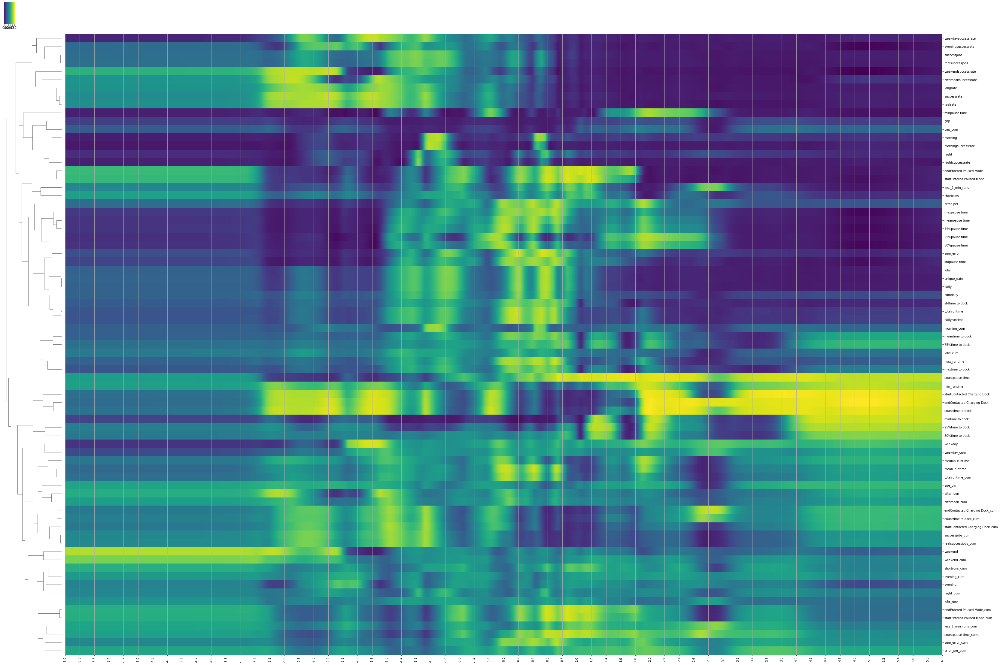

In [281]:
import seaborn as sns

clustergrid = sns.clustermap(decoded.T,cmap='viridis', 
                             cbar_kws={'orientation':'horizontal'},
                             figsize = (56,40),
                             col_cluster= False, 
                             #dendrogram_ratio=0.2, 
                             #cbar_pos=None
                            )
ax = clustergrid.ax_heatmap
feature_order = clustergrid.dendrogram_row.reordered_ind
ordered_labels = [data[skewlist].columns[i] for i in feature_order] 
ax.set_xticks(np.linspace(1,grid_n,n_grid_lines))
ax.set_xticklabels(['{:.5}'.format(a) for a in grid_lines ])
ax.set_yticklabels(ordered_labels)
ax.tick_params(axis='y',labelright=True, labelleft=False, 
                 left=False, labelrotation=0)
ax.grid(axis='x')

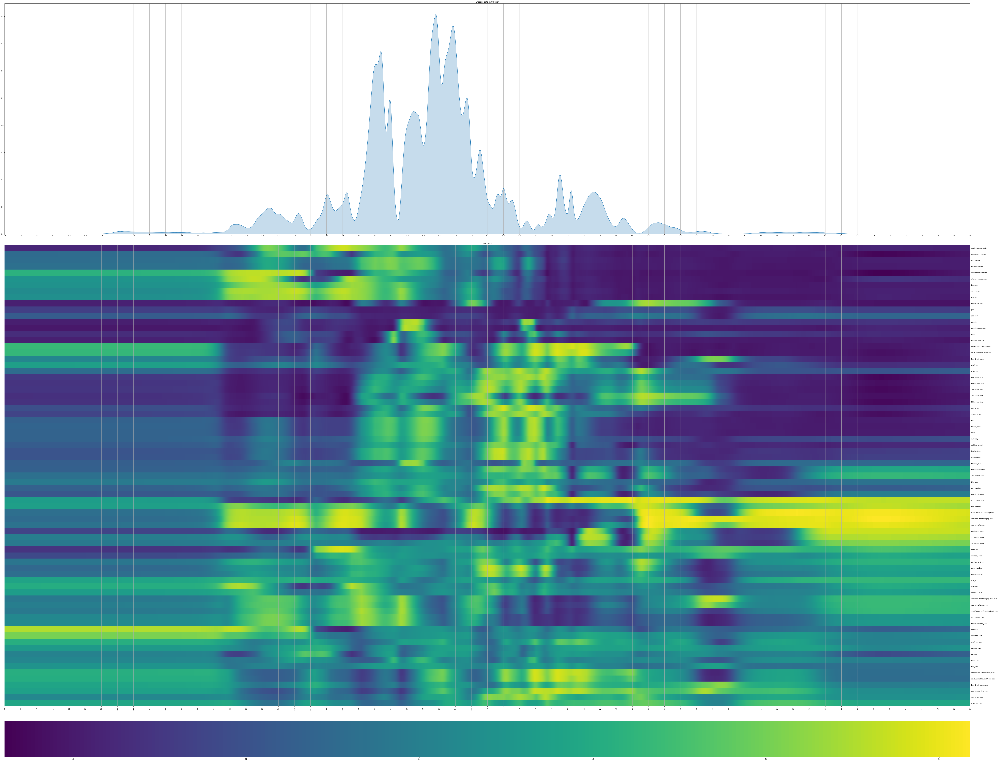

In [282]:
import seaborn as sns
import matplotlib.pyplot as plt
fig = plt.figure(figsize=(92,70),constrained_layout=True)
gs = fig.add_gridspec(3, 1)
ax1 = fig.add_subplot(gs[0,:])
ax2 = fig.add_subplot(gs[1:,:])

ax1.set_title('Encoded data distribution')
sns.kdeplot(encoded_data,bw=0.02, shade = True, ax=ax1, gridsize=2000)
ax1.set_xticks( grid_lines )
ax1.set_xlim(min_x,max_x)
ax1.grid(axis='x')

ax2.set_title('VAE types')

sns.heatmap(decoded.T[feature_order],cmap='viridis',ax=ax2, cbar_kws={'orientation':'horizontal'})
ax2.set_xticks(np.linspace(1,grid_n,n_grid_lines))
ax2.set_xticklabels(['{:.9}'.format(a) for a in grid_lines ])
ax2.set_yticklabels(ordered_labels)
ax2.tick_params(axis='y',labelright=True, labelleft=False, 
                left=False, labelrotation=0)


ax2.grid(axis='x')

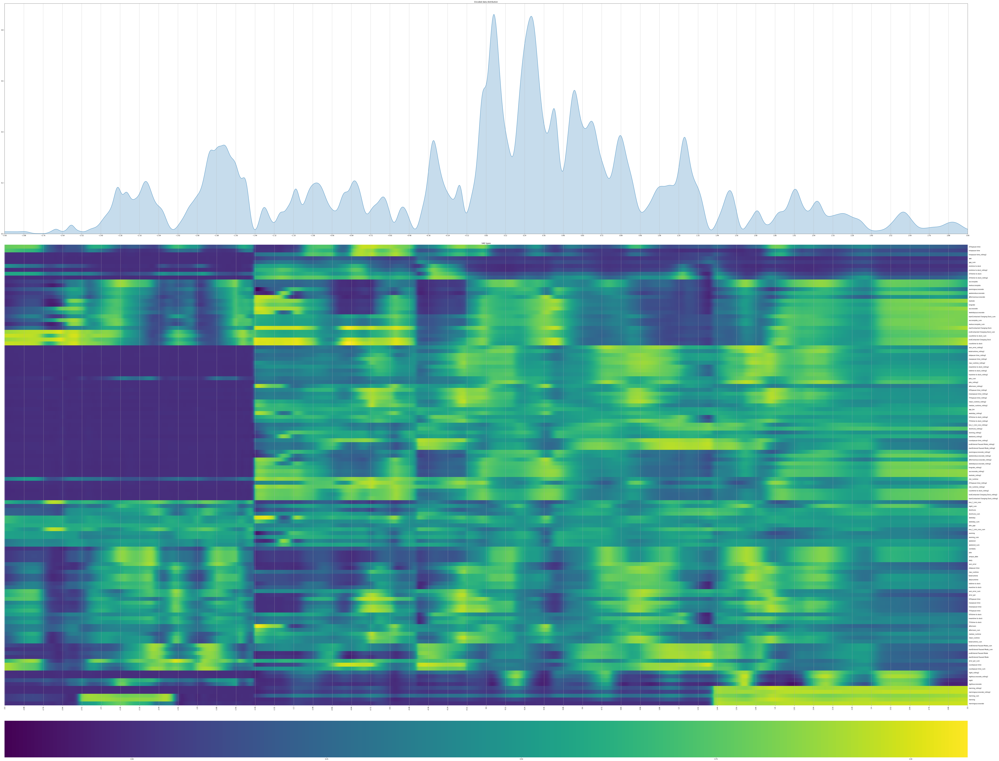

In [687]:
import seaborn as sns

fig = plt.figure(figsize=(92,70),constrained_layout=True)
gs = fig.add_gridspec(3, 1)
ax1 = fig.add_subplot(gs[0,:])
ax2 = fig.add_subplot(gs[1:,:])

ax1.set_title('Encoded data distribution')
sns.kdeplot(encoded_data,bw=0.02, shade = True, ax=ax1, gridsize=2000)
ax1.set_xticks( grid_lines )
ax1.set_xlim(min_x,max_x)
ax1.grid(axis='x')

ax2.set_title('VAE types')

sns.heatmap(decoded.T[feature_order],cmap='viridis',ax=ax2, cbar_kws={'orientation':'horizontal'})
ax2.set_xticks(np.linspace(1,grid_n,n_grid_lines))
ax2.set_xticklabels(['{:.9}'.format(a) for a in grid_lines ])
ax2.set_yticklabels(ordered_labels)
ax2.tick_params(axis='y',labelright=True, labelleft=False, 
                left=False, labelrotation=0)


ax2.grid(axis='x')

In [562]:
sum((encoded_data<0.533)&(encoded_data>-0.533))/len(encoded_data)

0.6801009338228413

In [410]:
#del final_df

In [45]:
#final_df=final_df.reset_index(drop=True)

[0.19682952 0.13599249 0.11594259 0.0662265  0.04994504 0.0366079
 0.03485724 0.03282764 0.02638298 0.0230157  0.01840847 0.01487406
 0.01443549 0.01251254 0.01121136 0.0106775  0.00977107 0.00876164
 0.00853541 0.00774258]


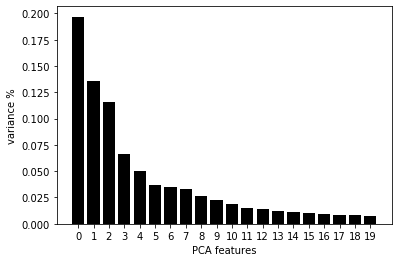

In [74]:
from sklearn.decomposition import PCA
pca = PCA(n_components=20)
principalComponents = pca.fit_transform(qt[skewlist])

# filename = 'pca_nav_new_month.sav'
# pickle.dump(pca_nav, open(filename, 'wb'))


# Plot the explained variances
features = range(pca.n_components_)
plt.bar(features, pca.explained_variance_ratio_, color='black')

print(pca.explained_variance_ratio_)
plt.xlabel('PCA features')
plt.ylabel('variance %')
plt.xticks(features)

PCA_components= pd.DataFrame(principalComponents)

Text(0, 0.5, 'PCA 3')

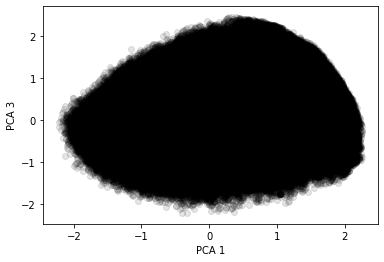

In [604]:
plt.scatter(PCA_components[1], PCA_components[2], alpha=.1, color='black')
plt.xlabel('PCA 1')
plt.ylabel('PCA 3')

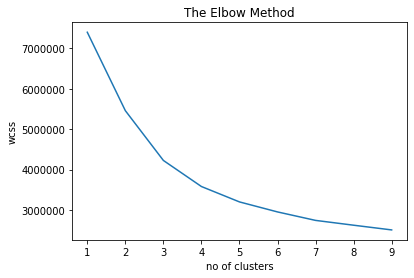

In [765]:
from sklearn.cluster import KMeans
wcss=[]
for i in range(1,10):
        kmeans = KMeans(n_clusters= i, init='k-means++', random_state=0)
        kmeans.fit(PCA_components.iloc[:,:6])
        wcss.append(kmeans.inertia_)
    #Visualizing the ELBOW method to get the optimal value of K 
    
plt.plot(range(1,10), wcss)
plt.title('The Elbow Method')
plt.xlabel('no of clusters')
plt.ylabel('wcss')
plt.show()

In [76]:
pca_data=PCA_components.iloc[:,:6]


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
The `size` parameter has been renamed to `height`; pleaes update your code.
invalid value encountered in true_divide
invalid value encountered in double_scalars
invalid value encountered in true_divide
invalid value encountered in double_scalars
invalid value encountered in true_divide
invalid value encountered in double_scalars
invalid value encountered in true_divide
invalid value encountered in double_scalars


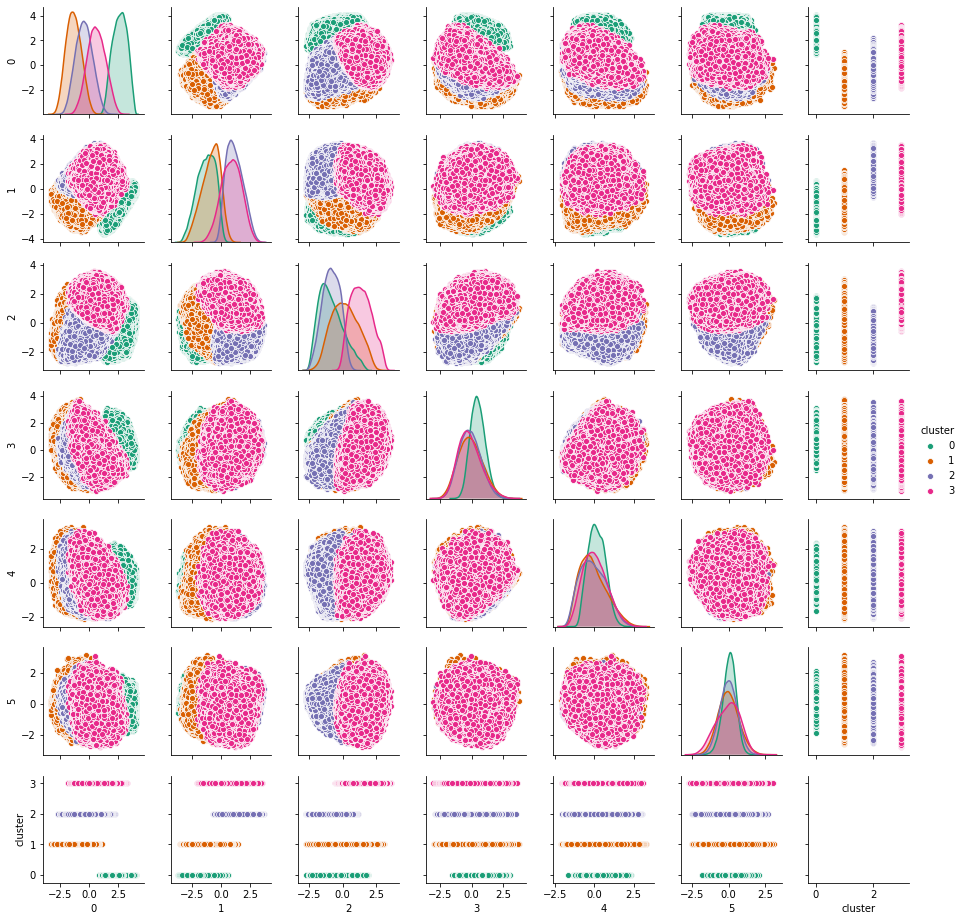

In [112]:
from sklearn.cluster import KMeans


kmeansmodel = KMeans(n_clusters= 4, init='k-means++', random_state=0)
y_kmeans_nav= kmeansmodel.fit_predict(pca_data)
# nav_pca_tsne_df=pd.DataFrame(nav_tsne)


pca_data['cluster']=y_kmeans_nav
sns.pairplot(pca_data, hue='cluster', palette= 'Dark2', diag_kind='kde',size=1.85)

In [113]:
pca_data['cluster'].value_counts()/len(pca_data)

1    0.353577
2    0.260962
3    0.217134
0    0.168328
Name: cluster, dtype: float64

In [114]:
pca_data['cluster'].value_counts()

1    350210
2    258477
3    215066
0    166725
Name: cluster, dtype: int64

In [115]:
xgblist=['age_bin', 'endContacted Charging Dock', 'endEntered Paused Mode', 'startContacted Charging Dock', 'startEntered Paused Mode', 'jobs', 'max_runtime', 'min_runtime', 'mean_runtime', 'median_runtime', 'totalruntime', 'sum_error', 'successrate', 'realrate', 'longrate', 'less_1_min_runs', 'shortruns', 'weekday', 'night', 'morning', 'afternoon', 'evening', 'counttime to dock', 'meantime to dock', 'stdtime to dock', 'mintime to dock', '25%time to dock', '50%time to dock', '75%time to dock', 'maxtime to dock', 'countpause time', 'meanpause time', 'stdpause time', 'minpause time', '25%pause time', '50%pause time', '75%pause time', 'maxpause time', 'weekdaysuccessrate', 'nightsuccessrate', 'morningsuccessrate', 'afternoonsuccessrate', 'eveningsuccessrate', 'weekend', 'weekendsuccessrate', 'successjobs', 'realsuccessjobs', 'jobs_cum', 'endContacted Charging Dock_cum', 'endEntered Paused Mode_cum', 'startContacted Charging Dock_cum', 'startEntered Paused Mode_cum', 'sum_error_cum', 'less_1_min_runs_cum', 'totalruntime_cum', 'shortruns_cum', 'weekday_cum', 'night_cum', 'morning_cum', 'afternoon_cum', 'evening_cum', 'counttime to dock_cum', 'countpause time_cum', 'weekend_cum', 'successjobs_cum', 'realsuccessjobs_cum', 'gap', 'gap_cum', 'jobs_gap', 'unique_date', 'error_per', 'cumdaily', 'daily', 'dailyruntime', 'error_per_cum']

In [116]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
import shap
import xgboost
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score
model = XGBClassifier(max_depth= 3, eta= 1, learning_rate= 0.01,n_estimators=50)

model.fit(data[xgblist],y_kmeans_nav)

# explain the model's predictions using SHAP
# (same syntax works for LightGBM, CatBoost, scikit-learn and spark models)

explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(data[xgblist])

#predict_test = model.predict(test[cols].fillna(0).drop(['OEM Model','DSN','map_confidence'],axis=1))

predict_train = model.predict(data[xgblist])

Setting feature_perturbation = "tree_path_dependent" because no background data was given.


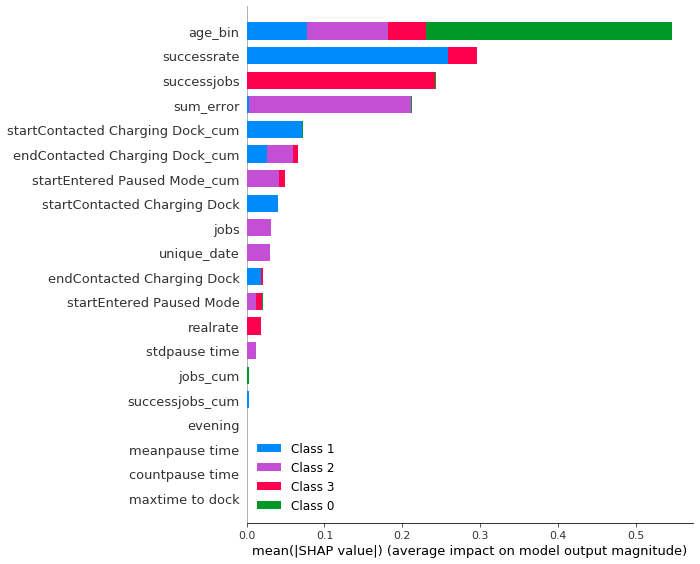

In [117]:
shap.summary_plot(shap_values, data[xgblist])


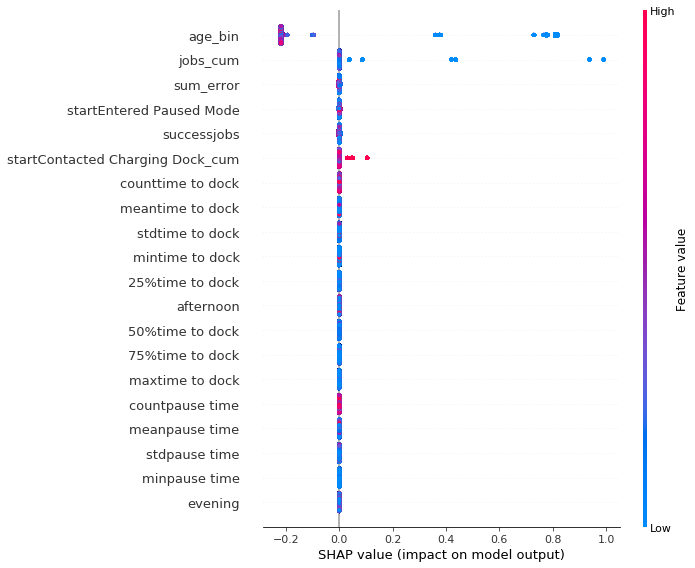

In [118]:
shap.summary_plot(shap_values[0], data[xgblist])

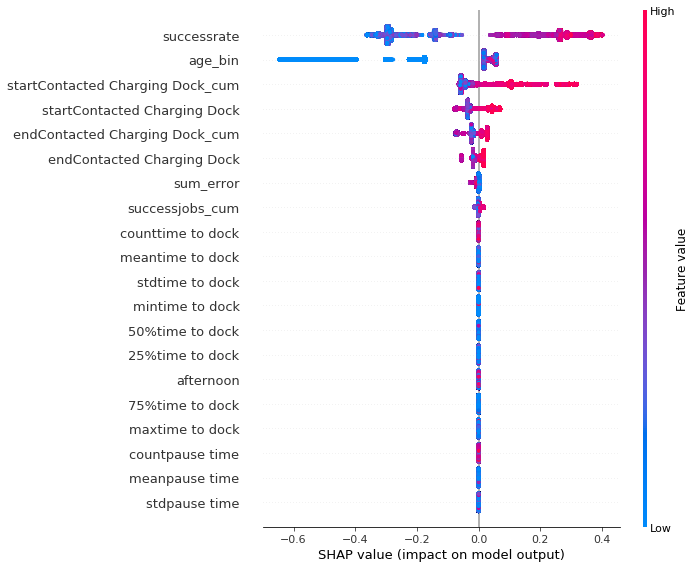

In [119]:
shap.summary_plot(shap_values[1], data[xgblist])

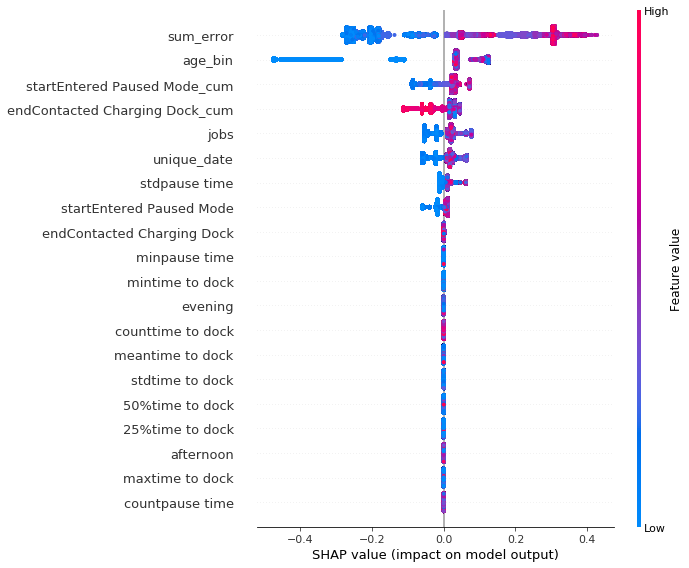

In [120]:
shap.summary_plot(shap_values[2], data[xgblist])

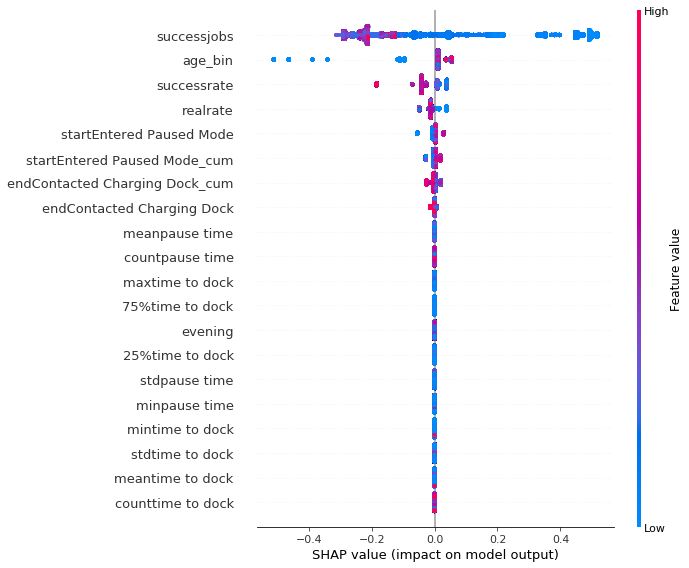

In [121]:
shap.summary_plot(shap_values[3], data[xgblist])

In [ ]:
#shap.summary_plot(shap_values[4], data[xgblist])

In [87]:
from tensorflow.keras import layers
from tensorflow.keras import backend as K
from tensorflow.keras.models import Model

input_shape = (train[skewlist].shape[1],)
latent_dim = 2  # Dimensionality of the latent space: a line
dense_width = 1024

input_x = keras.Input(shape=input_shape)

x = layers.Dense(dense_width, activation='relu')(input_x)
x = layers.Dense(dense_width, activation='relu')(x)
x = layers.Dense(dense_width, activation='relu')(x)
x = layers.Dense(dense_width, activation='sigmoid')(x)

z_mean = layers.Dense(latent_dim)(x)
z_log_var = layers.Dense(latent_dim)(x)

encoder = Model(input_x, z_mean)

In [88]:
def sampling(args):
    z_mean, z_log_var = args
    epsilon = K.random_normal(shape=(K.shape(z_mean)[0], latent_dim),
                              mean=0., stddev=1.)
    return z_mean + K.exp(z_log_var) * epsilon

z = layers.Lambda(sampling)([z_mean, z_log_var])

In [89]:
# This is the input where we will feed `z`.
decoder_input = layers.Input(K.int_shape(z)[1:])

# Upsample to the correct number of units
x = layers.Dense(dense_width,activation='relu')(decoder_input)
x = layers.Dense(dense_width,activation='relu')(x)
x = layers.Dense(dense_width,activation='relu')(x)
x = layers.Dense(dense_width,activation='sigmoid')(x)

x = layers.Dense(input_shape[0])(x)

# This is our decoder model.
decoder = Model(decoder_input, x)

# We then apply it to `z` to recover the decoded `z`.
z_decoded = decoder(z)


In [90]:
class CustomVariationalLayer(keras.layers.Layer):

    def vae_loss(self, x, z_decoded):
        xent_loss = keras.metrics.mse(x, z_decoded)
        kl_loss = -5e-4 * K.mean(
            1 + z_log_var - K.square(z_mean) - K.exp(z_log_var), axis=-1)
        return K.mean(xent_loss + kl_loss)

    def call(self, inputs):
        x = inputs[0]
        z_decoded = inputs[1]
        loss = self.vae_loss(x, z_decoded)
        self.add_loss(loss, inputs=inputs)
        # We don't use this output.
        return x

# We call our custom layer on the input and the decoded output,
# to obtain the final model output.
y = CustomVariationalLayer()([input_x, z_decoded])

vae = Model(input_x, y)

In [91]:
train.shape

(792382, 121)

In [92]:
vae.compile(optimizer='adam', loss=None)

n_batch_sizes=1

history =['']*n_batch_sizes
titles  =['']*n_batch_sizes

# Train the VAE on boston housing data

for i in range(n_batch_sizes):

  # Alternate between a few epochs with large batch size (reliable decrease in 
  # loss but weak and overfitting) and lots of epochs with small batch size
  # (strong and non-overfitting but could increase loss)
    batch_size = 1024*(1-(i%2)) + 512*(i%2)
    epochs = 20*(1-(i%2)) + 50*(i%2)

    print('Batch size:', batch_size)
    titles[i] = 'Round {}, Batch size {}'.format(i+1, batch_size)

    history[i] = vae.fit(x=train[skewlist], y=None,
                       shuffle=True,
                       epochs=epochs,
                       batch_size=batch_size,
                       validation_data=(test[skewlist], None))


Batch size: 1024
Train on 792382 samples, validate on 198096 samples
Epoch 1/20
792382/792382 [==============================] - 120s 152us/sample - loss: 0.0680 - val_loss: 0.0528
Epoch 2/20
792382/792382 [==============================] - 147s 185us/sample - loss: 0.0506 - val_loss: 0.0488
Epoch 3/20
792382/792382 [==============================] - 128s 162us/sample - loss: 0.0489 - val_loss: 0.0480
Epoch 4/20
792382/792382 [==============================] - 138s 174us/sample - loss: 0.0476 - val_loss: 0.0473
Epoch 5/20
792382/792382 [==============================] - 131s 166us/sample - loss: 0.0471 - val_loss: 0.0460
Epoch 6/20
792382/792382 [==============================] - 131s 165us/sample - loss: 0.0463 - val_loss: 0.0468
Epoch 7/20
792382/792382 [==============================] - 132s 166us/sample - loss: 0.0458 - val_loss: 0.0466
Epoch 8/20
792382/792382 [==============================] - 131s 166us/sample - loss: 0.0454 - val_loss: 0.0447
Epoch 9/20
792382/792382 [=========

In [93]:
encoded_2=encoder.predict(qt[skewlist])
encoded_2.shape

(990478, 2)

In [151]:
pickle.dump(encoder, open('encoder_2dimension.sav', 'wb'))
pickle.dump(encoded_2, open('encoded_2dimension.sav', 'wb'))
pickle.dump(encoded, open('encoded_1dimension.sav', 'wb'))




TypeError: can't pickle _thread.RLock objects

In [ ]:
# import seaborn as sns

# clustergrid = sns.clustermap(decoded.T,cmap='viridis', 
#                              cbar_kws={'orientation':'horizontal'},
#                              figsize = (56,40),
#                              col_cluster= False, 
#                              #dendrogram_ratio=0.2, 
#                              #cbar_pos=None
#                             )
# ax = clustergrid.ax_heatmap
# feature_order = clustergrid.dendrogram_row.reordered_ind
# ordered_labels = [data[skewlist].columns[i] for i in feature_order] 
# ax.set_xticks(np.linspace(1,grid_n,n_grid_lines))
# ax.set_xticklabels(['{:.5}'.format(a) for a in grid_lines ])
# ax.set_yticklabels(ordered_labels)
# ax.tick_params(axis='y',labelright=True, labelleft=False, 
#                  left=False, labelrotation=0)
# ax.grid(axis='x')

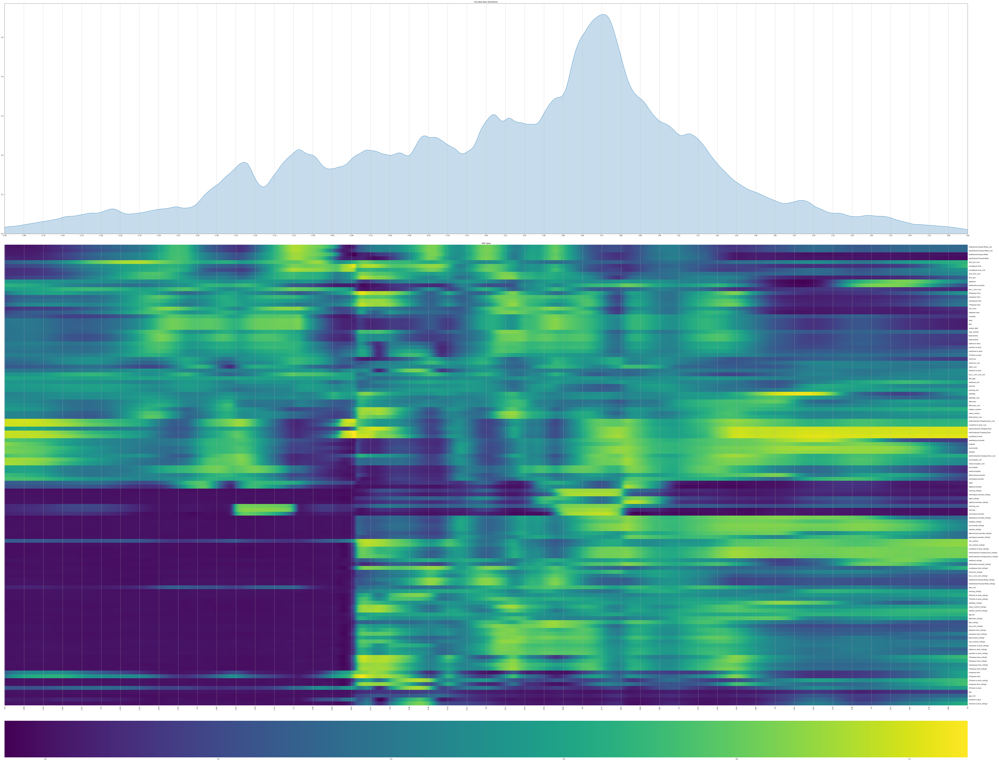

In [791]:
# import seaborn as sns

# fig = plt.figure(figsize=(92,70),constrained_layout=True)
# gs = fig.add_gridspec(3, 1)
# ax1 = fig.add_subplot(gs[0,:])
# ax2 = fig.add_subplot(gs[1:,:])

# ax1.set_title('Encoded data distribution')
# sns.kdeplot(encoded_2,bw=0.02, shade = True, ax=ax1, gridsize=2000)
# ax1.set_xticks( grid_lines )
# ax1.set_xlim(min_x,max_x)
# ax1.grid(axis='x')

# ax2.set_title('VAE types')

# sns.heatmap(decoded.T[feature_order],cmap='viridis',ax=ax2, cbar_kws={'orientation':'horizontal'})
# ax2.set_xticks(np.linspace(1,grid_n,n_grid_lines))
# ax2.set_xticklabels(['{:.9}'.format(a) for a in grid_lines ])
# ax2.set_yticklabels(ordered_labels)
# ax2.tick_params(axis='y',labelright=True, labelleft=False, 
#                 left=False, labelrotation=0)


# ax2.grid(axis='x')

In [803]:
encoded_2[0]

array([ 0.5515374, -3.923586 ], dtype=float32)

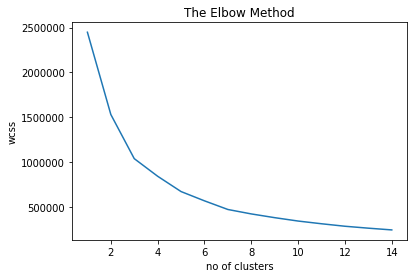

In [94]:
from sklearn.cluster import KMeans
wcss=[]
for i in range(1,15):
        kmeans_1 = KMeans(n_clusters= i, init='k-means++', random_state=0)
        kmeans_1.fit(encoded_2)
        wcss.append(kmeans_1.inertia_)
    #Visualizing the ELBOW method to get the optimal value of K 
    
plt.plot(range(1,15), wcss)
plt.title('The Elbow Method')
plt.xlabel('no of clusters')
plt.ylabel('wcss')
plt.show()

In [779]:
encoded_data[0]

-1.2147732

In [122]:
kmeansmodel_1 = KMeans(n_clusters= 7, init='k-means++', random_state=0)
y_kmeans_1= kmeansmodel_1.fit_predict(encoded_2)
# nav_pca_tsne_df=pd.DataFrame(nav_tsne)




In [123]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
import shap
import xgboost
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score
model_1 = XGBClassifier(max_depth= 3, eta= 1, learning_rate= 0.01,n_estimators=200)

model_1.fit(data[xgblist],y_kmeans_1)

# explain the model's predictions using SHAP
# (same syntax works for LightGBM, CatBoost, scikit-learn and spark models)

explainer_1 = shap.TreeExplainer(model_1)
shap_values_1 = explainer_1.shap_values(data[xgblist])

#predict_test = model.predict(test[cols].fillna(0).drop(['OEM Model','DSN','map_confidence'],axis=1))




Setting feature_perturbation = "tree_path_dependent" because no background data was given.


In [124]:
pd.Series(y_kmeans_1).value_counts()

5    294521
0    218986
1    133198
3    107857
4    102506
6     94798
2     38612
dtype: int64

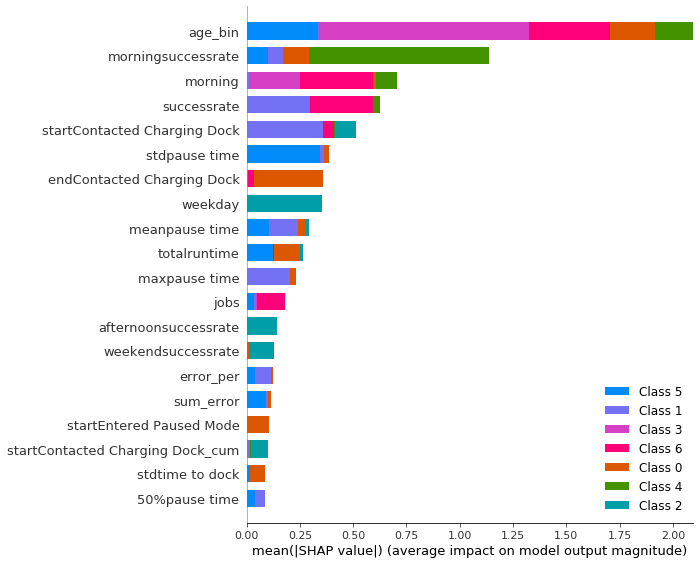

In [125]:
shap.summary_plot(shap_values_1, data[xgblist])



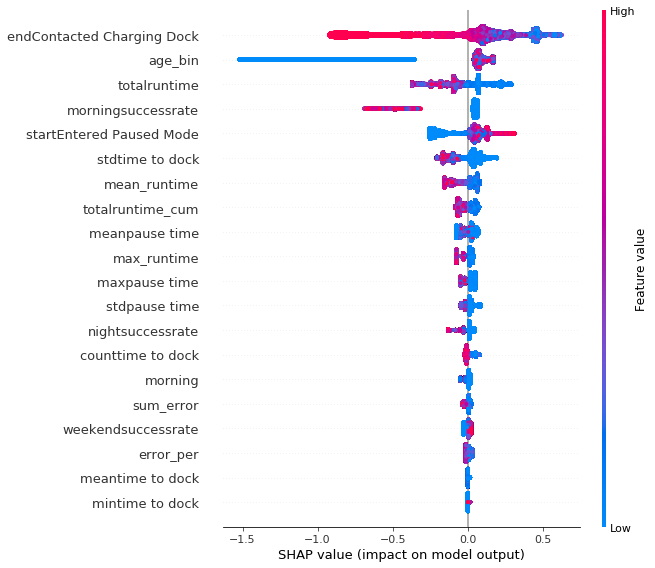

In [126]:
#bad,old
shap.summary_plot(shap_values_1[0], data[xgblist])

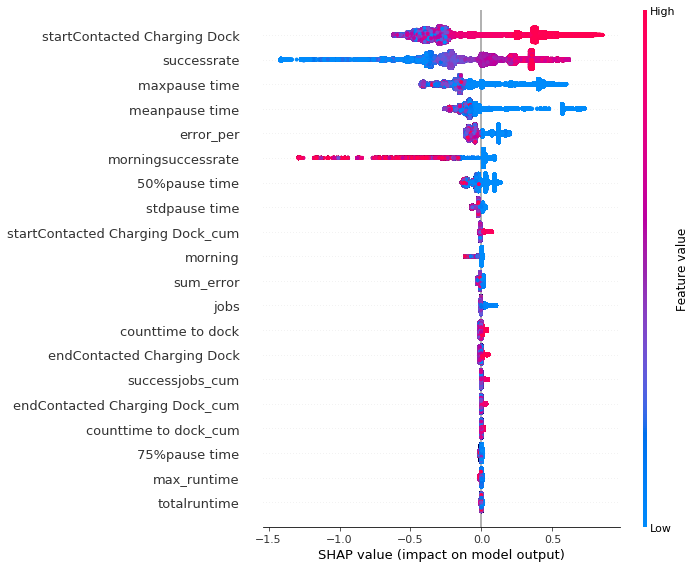

In [127]:
#good,old
shap.summary_plot(shap_values_1[1], data[xgblist])

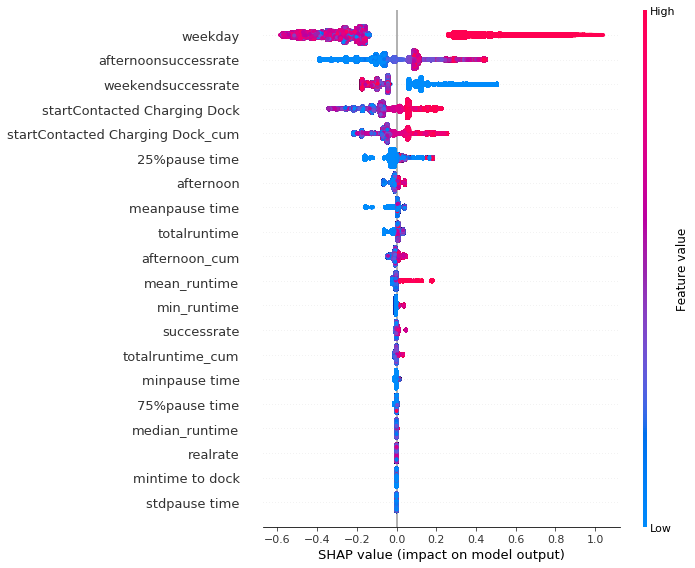

In [128]:
#afternoon&evening good,old
shap.summary_plot(shap_values_1[2], data[xgblist])

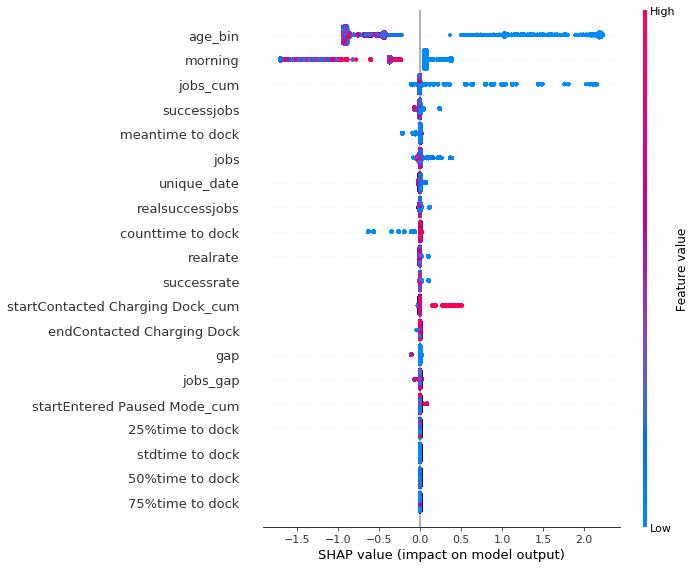

In [129]:
#morning&night good,old
shap.summary_plot(shap_values_1[3], data[xgblist])

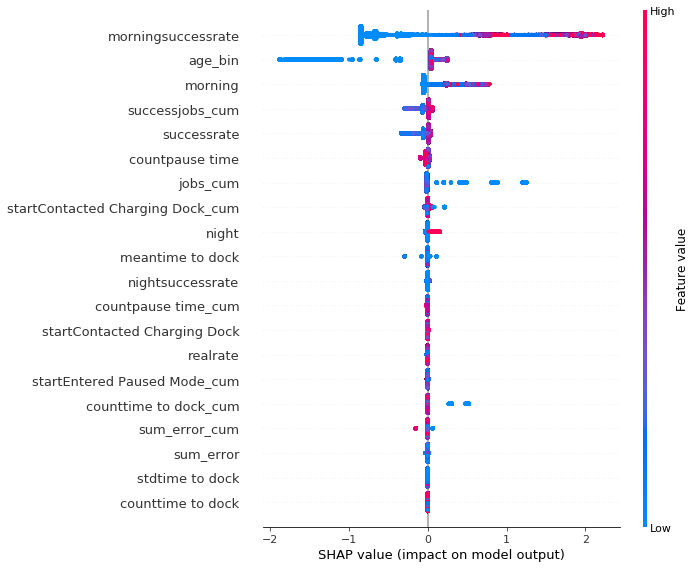

In [130]:
#new,less jobs,good
shap.summary_plot(shap_values_1[4], data[xgblist])

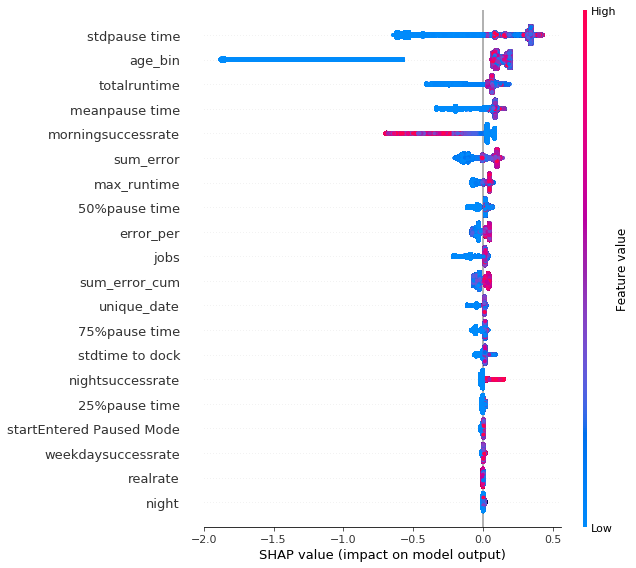

In [131]:
shap.summary_plot(shap_values_1[5], data[xgblist])

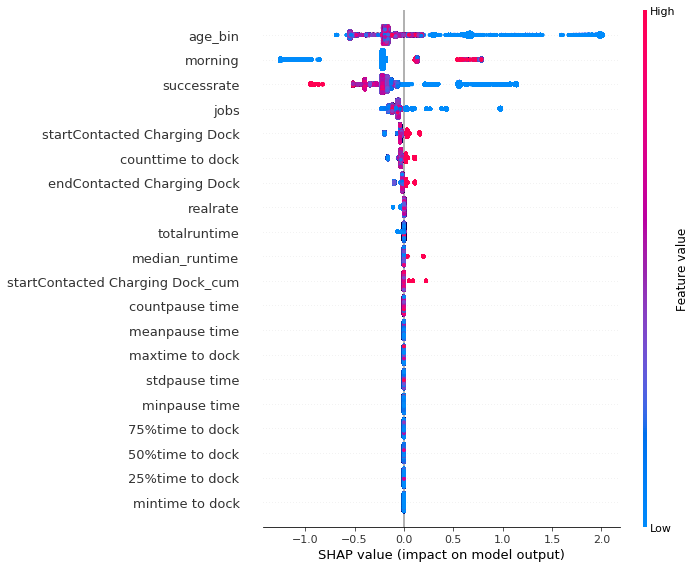

In [132]:
shap.summary_plot(shap_values_1[6], data[xgblist])

In [140]:
kmeansmodel_5 = KMeans(n_clusters= 5, init='k-means++', random_state=0)
y_kmeans_5= kmeansmodel_5.fit_predict(encoded_2)
# nav_pca_tsne_df=pd.DataFrame(nav_tsne)


from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
import shap
import xgboost
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score
model_5 = XGBClassifier(max_depth= 3, eta= 1, learning_rate= 0.01,n_estimators=200)

model_5.fit(data[xgblist],y_kmeans_5)

# explain the model's predictions using SHAP
# (same syntax works for LightGBM, CatBoost, scikit-learn and spark models)

explainer_5 = shap.TreeExplainer(model_5)
shap_values_5 = explainer_5.shap_values(data[xgblist])

#predict_test = model.predict(test[cols].fillna(0).drop(['OEM Model','DSN','map_confidence'],axis=1))


Setting feature_perturbation = "tree_path_dependent" because no background data was given.


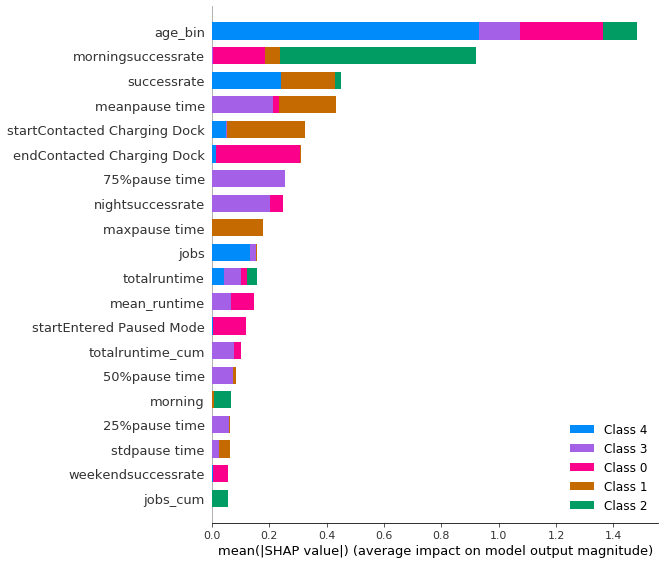

In [141]:
shap.summary_plot(shap_values_5, data[xgblist])



In [147]:
pd.Series(y_kmeans_5).value_counts()

0    312796
3    240105
4    191248
1    130616
2    115713
dtype: int64

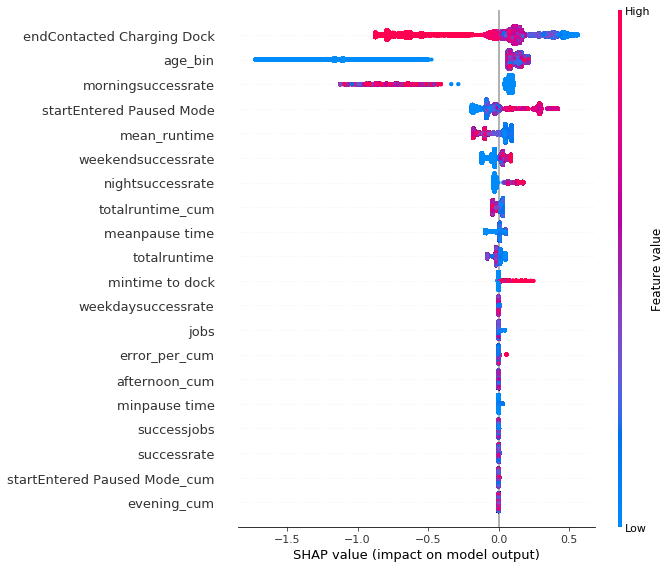

In [142]:
shap.summary_plot(shap_values_5[0], data[xgblist])

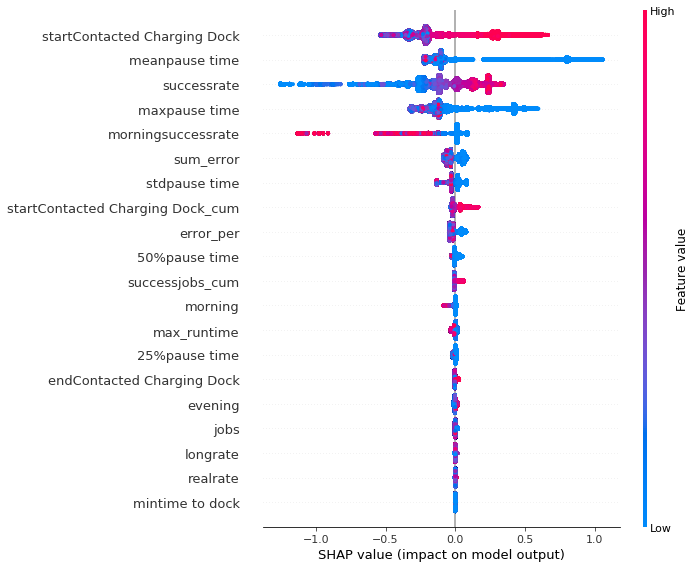

In [143]:
shap.summary_plot(shap_values_5[1], data[xgblist])

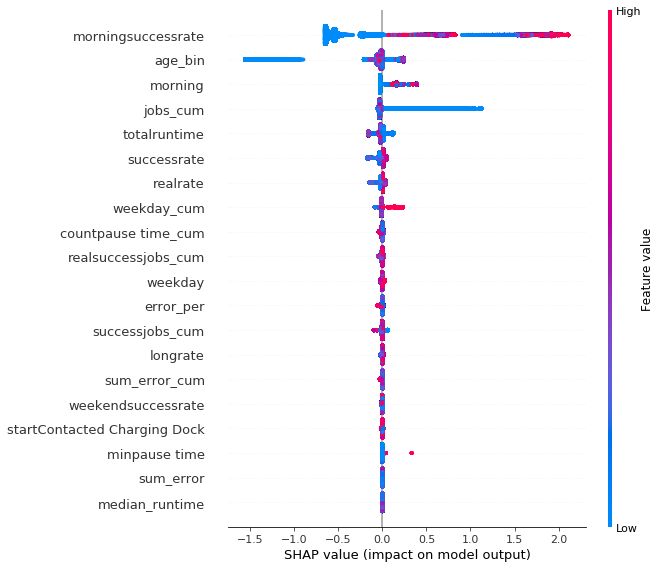

In [144]:
shap.summary_plot(shap_values_5[2], data[xgblist])

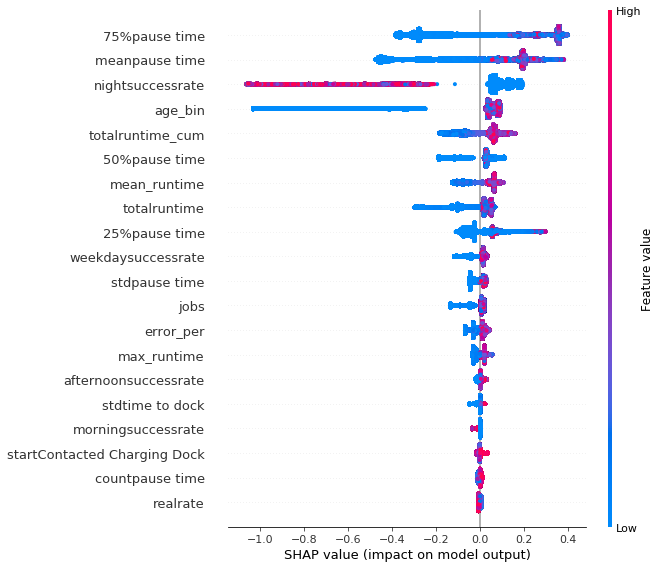

In [145]:
shap.summary_plot(shap_values_5[3], data[xgblist])

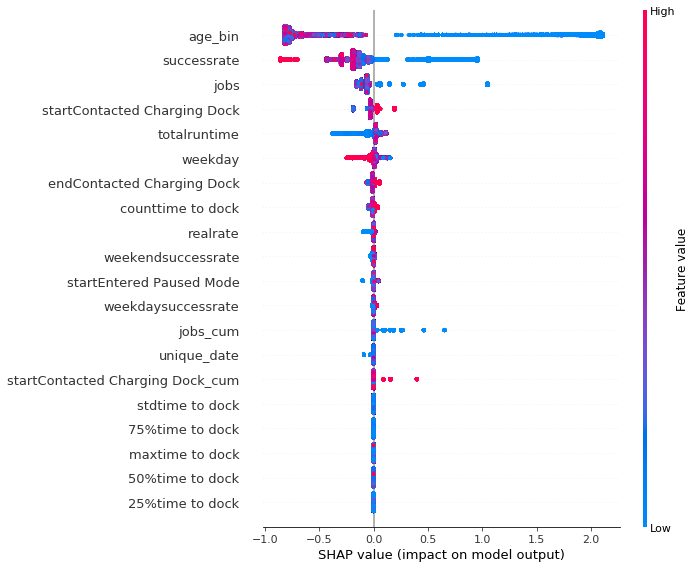

In [146]:
shap.summary_plot(shap_values_5[4], data[xgblist])

In [1]:
shap.initjs()
for i in range(75):
    #print(i)
    
    display(shap.force_plot(explainer_1.expected_value[0], shap_values_1[0][i], data[xgblist].iloc[i]))
   




NameError: name 'shap' is not defined

In [150]:
pickle.dump(model, open('xgb_kmean.sav', 'wb'))
pickle.dump(model_1, open('xgb_vae_7.sav', 'wb'))
pickle.dump(model_5, open('xgb_vae_5.sav', 'wb'))





In [283]:
encoded_data.max(),encoded_data.min()

(7.6545005, -6.575421)

In [284]:
data['auto_encode']=encoded_data




In [285]:
data['kmeans']=y_kmeans_nav
data['vae_kmeans_7']=y_kmeans_1
data['vae_kmeans_5']=y_kmeans_5

In [286]:
data.to_csv('./Auto_encoder/cluster_result.csv',index=False)

In [287]:
data.shape

(990478, 126)

In [288]:
data[data['auto_encode']>-0.6].shape

(452619, 126)

In [289]:
data[data['auto_encode']>0.6].shape

(126792, 126)

In [158]:
data.columns

Index(['OEM_MODEL', 'DSN', 'age_bin', 'endContacted Charging Dock',
       'endEntered Paused Mode', 'startContacted Charging Dock',
       'startEntered Paused Mode', 'date', 'jobs', 'max_runtime',
       ...
       'unique_date', 'error_per', 'cumdaily', 'daily', 'dailyruntime',
       'error_per_cum', 'auto_encode', 'kmeans', 'vae_kmeans_7',
       'vae_kmeans_5'],
      dtype='object', length=126)

In [295]:
data['label']=np.where((data['kmeans']>=2)&(data['vae_kmeans_5']>=3)&(data['vae_kmeans_7']>=5)&(data['auto_encode']>=-0.6),'bad','good')

In [215]:
sample=data.sample(n=500, random_state=1)

vae-7means

In [238]:
#TP_TN = [i for i in range(len(pred)) if pred[i] == y_test.values[i]] 
shap_values = explainer_1.shap_values(sample[xgblist])


In [239]:
shap.initjs()
shap.force_plot(explainer_1.expected_value[3], shap_values[3], sample[xgblist],feature_names=xgblist,link='logit')

In [240]:
shap.force_plot(explainer_1.expected_value[5], shap_values[5], sample[xgblist],feature_names=xgblist,link='logit')

In [241]:
shap.force_plot(explainer_1.expected_value[6], shap_values[6], sample[xgblist],feature_names=xgblist,link='logit')

vae-5means

In [242]:
shap_values = explainer_5.shap_values(sample[xgblist])


In [243]:
shap.force_plot(explainer_1.expected_value[3], shap_values[3], sample[xgblist],feature_names=xgblist,link='logit')

In [245]:
shap.force_plot(explainer_1.expected_value[4], shap_values[4], sample[xgblist],feature_names=xgblist,link='logit')

4means

In [246]:
shap_values = explainer.shap_values(sample[xgblist])


In [247]:
shap.force_plot(explainer.expected_value[2], shap_values[2], sample[xgblist],feature_names=xgblist,link='logit')

In [248]:
shap.force_plot(explainer.expected_value[3], shap_values[3], sample[xgblist],feature_names=xgblist,link='logit')

In [227]:
encoded_data.min(),encoded_data.max()

(-4.607503, 6.2551355)

In [252]:
decoded.shape

(3601, 119)

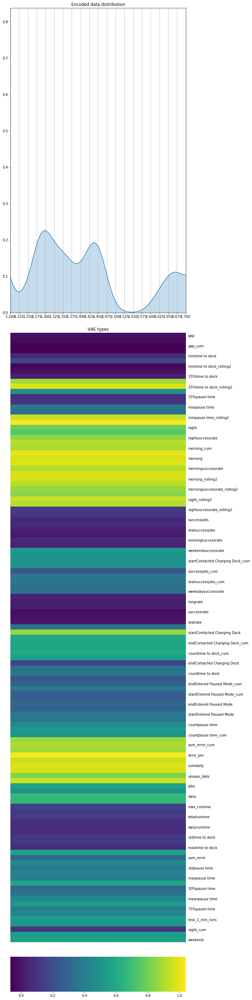

In [254]:
min_x, max_x, grid_n = 1.2, 1.7, 401
grid_x = np.linspace(min_x,max_x,grid_n)
n_grid_lines=21
grid_lines = np.linspace(min_x,max_x,n_grid_lines)
fig = plt.figure(figsize=(10,40),constrained_layout=True)
gs = fig.add_gridspec(3, 1)
ax1 = fig.add_subplot(gs[0,:])
ax2 = fig.add_subplot(gs[1:,:])

ax1.set_title('Encoded data distribution')
sns.kdeplot(encoded_data,bw=0.02, shade = True, ax=ax1, gridsize=2000)
ax1.set_xticks( grid_lines )
ax1.set_xlim(min_x,max_x)
ax1.grid(axis='x')

ax2.set_title('VAE types')

sns.heatmap(decoded.T[feature_order],cmap='viridis',ax=ax2, cbar_kws={'orientation':'horizontal'})
ax2.set_xticks(np.linspace(1,grid_n,n_grid_lines))
ax2.set_xticklabels(['{:.2}'.format(a) for a in grid_lines ])
ax2.set_yticklabels(ordered_labels)
ax2.tick_params(axis='y',labelright=True, labelleft=False, 
                left=False, labelrotation=0)

#


ax2.grid(axis='x')

In [353]:
sum(predict_train_prob.max(axis=1)>0.5)/len(predict_train_prob)

0.9980931236067716

In [354]:
sum(predict_test_prob.max(axis=1)>0.6)/len(predict_test_prob)

0.9014084507042254

In [181]:
decoded.shape

(3601, 119)

In [182]:
len(feature_order)

119

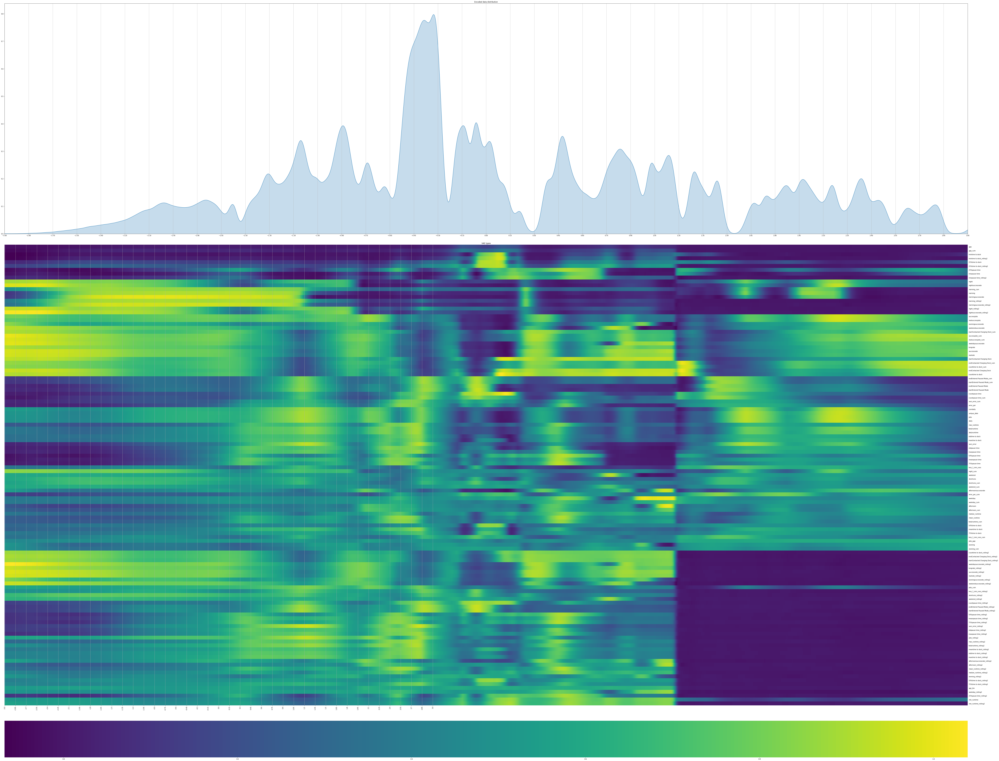

In [231]:
decoded=decoder.predict(grid_x)
decoded.shape
fig = plt.figure(figsize=(92,70),constrained_layout=True)
gs = fig.add_gridspec(3, 1)
ax1 = fig.add_subplot(gs[0,:])
ax2 = fig.add_subplot(gs[1:,:])

ax1.set_title('Encoded data distribution')
sns.kdeplot(encoded_data,bw=0.02, shade = True, ax=ax1, gridsize=2000)
ax1.set_xticks( grid_lines )
ax1.set_xlim(min_x,max_x)
ax1.grid(axis='x')

ax2.set_title('VAE types')

sns.heatmap(decoded.T[feature_order],cmap='viridis',ax=ax2, cbar_kws={'orientation':'horizontal'})
ax2.set_xticks(np.linspace(1,grid_n,n_grid_lines))
ax2.set_xticklabels(['{:.9}'.format(a) for a in grid_lines ])
ax2.set_yticklabels(ordered_labels)
ax2.tick_params(axis='y',labelright=True, labelleft=False, 
                left=False, labelrotation=0)


ax2.grid(axis='x')

In [297]:
data['label'].value_counts()

good    869861
bad     120617
Name: label, dtype: int64

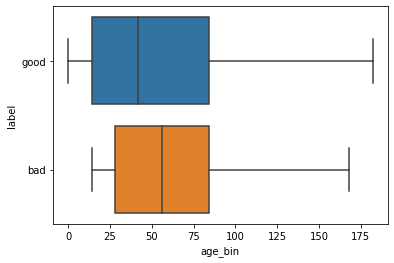

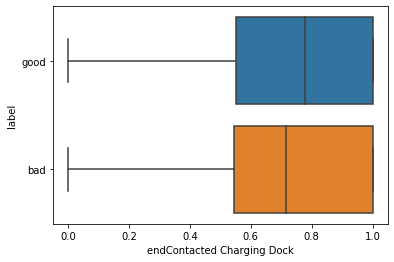

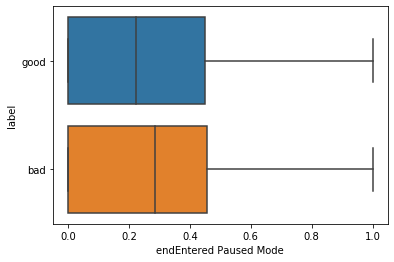

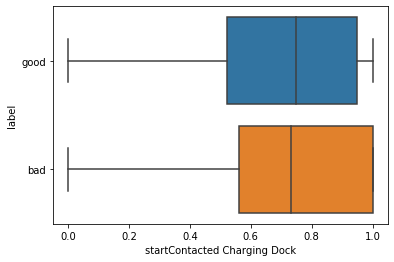

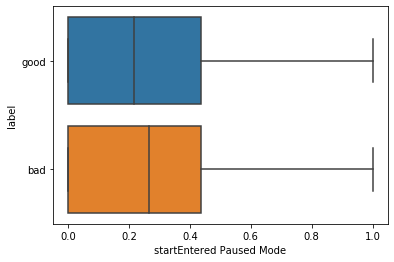

...

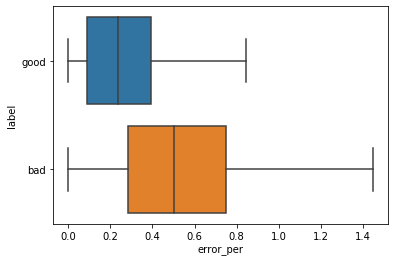

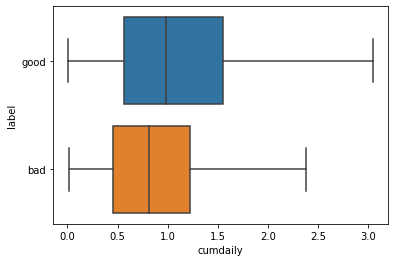

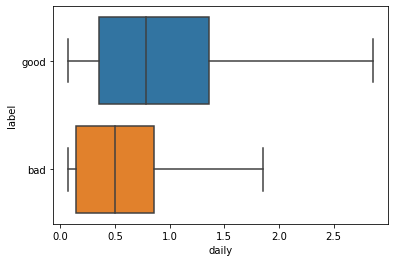

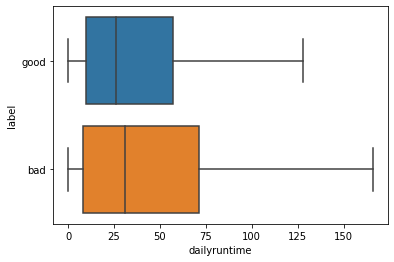

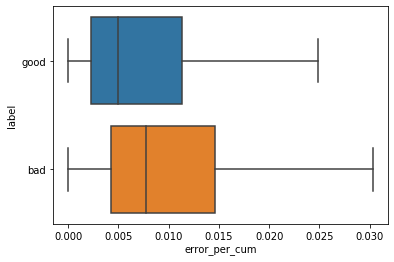

In [298]:
for i in skewlist:
    sns.boxplot(x=data[i],y=data['label'],data=data,showfliers=False)
    plt.show()
    

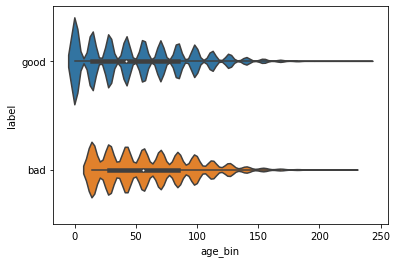

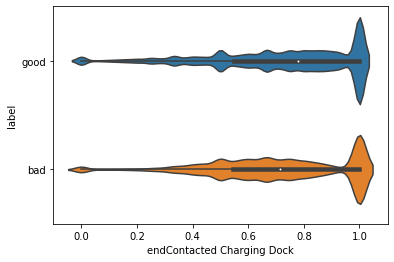

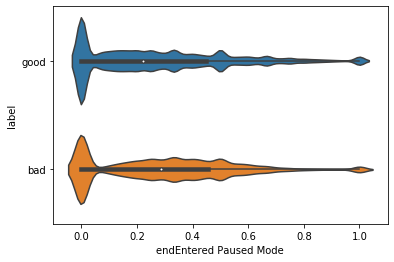

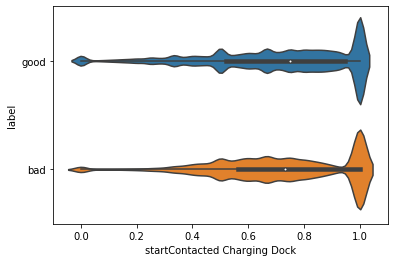

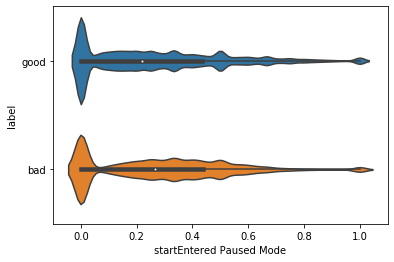

...

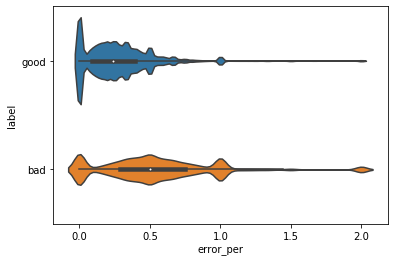

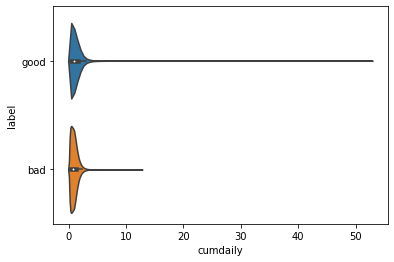

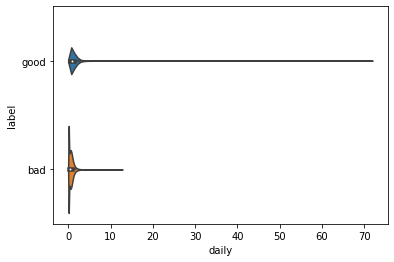

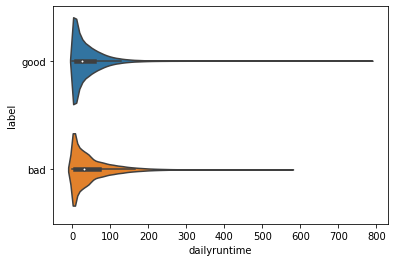

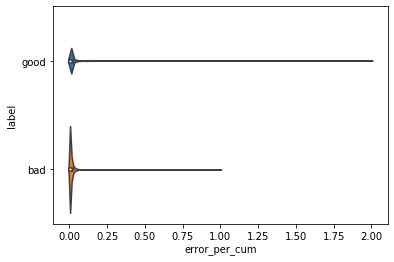

In [306]:
for i in skewlist:
    sns.violinplot(x=data[i],y=data['label'],data=data)
    plt.show()

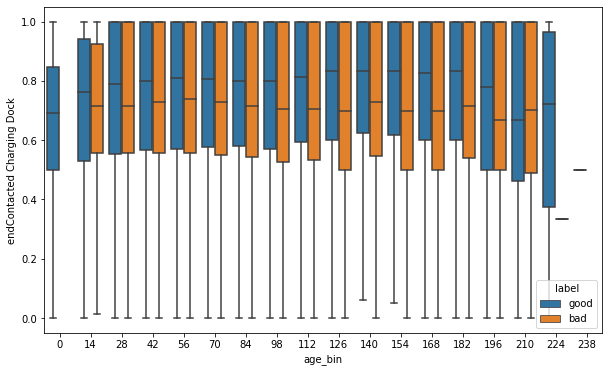

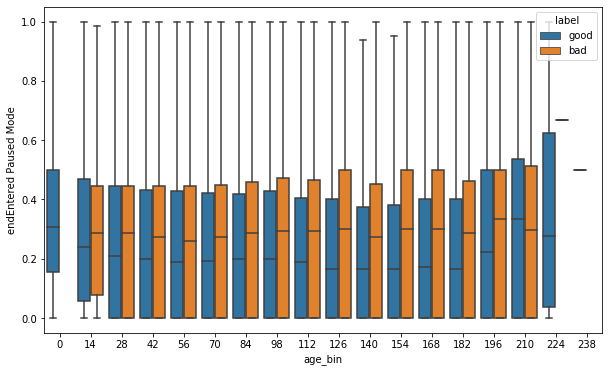

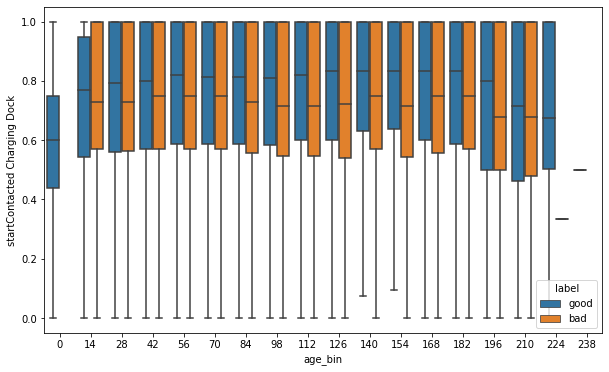

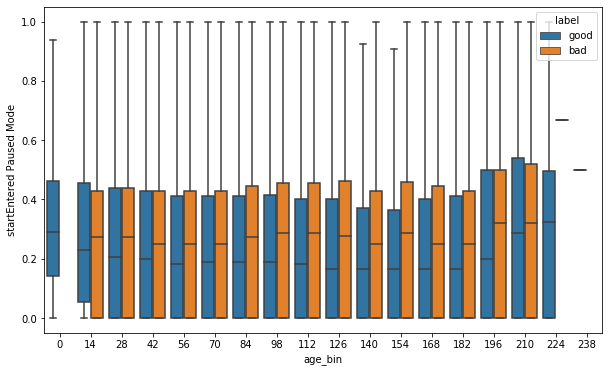

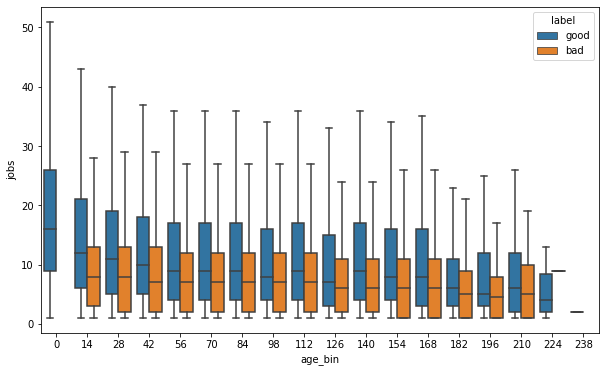

...

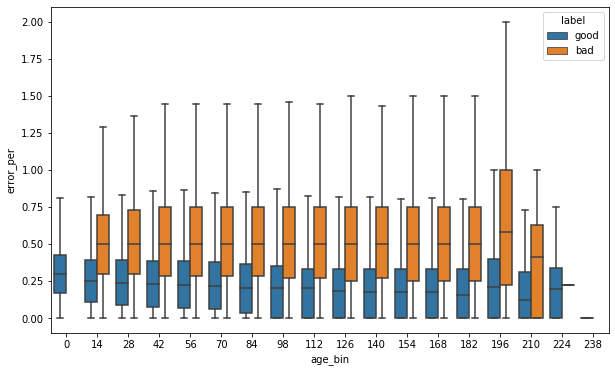

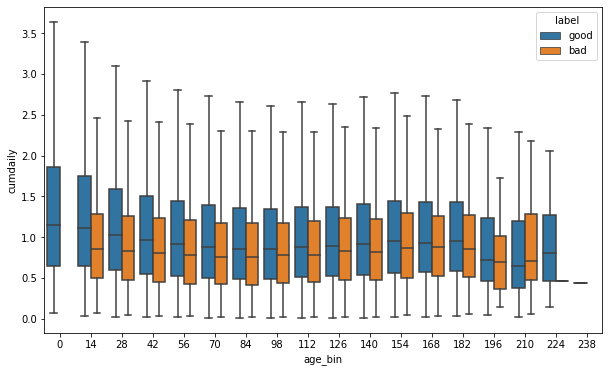

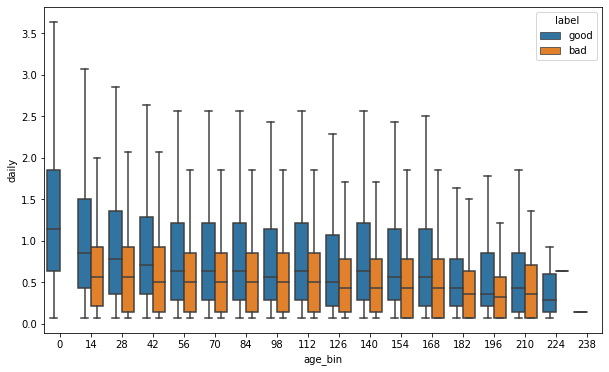

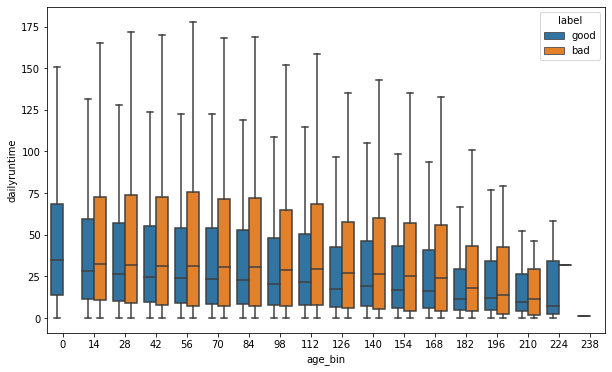

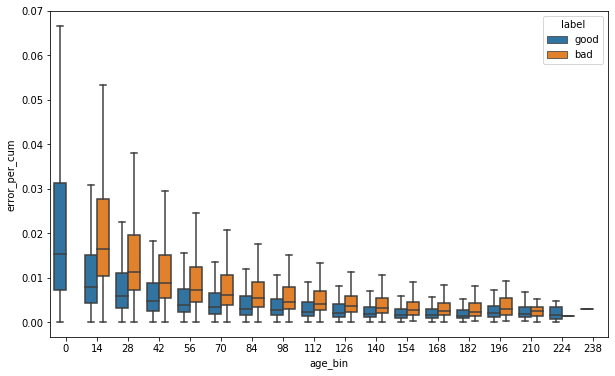

In [314]:
for i in skewlist[1:]:
    plt.figure(figsize=(10,6))
    sns.boxplot(y=data[i],x=data['age_bin'],hue=data['label'],data=data,showfliers=False)
    plt.show()

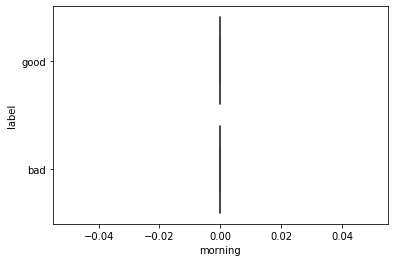

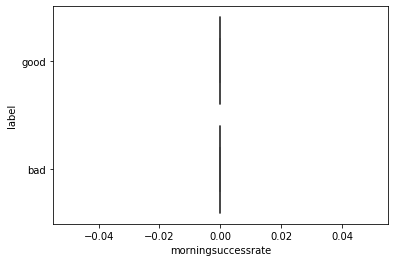

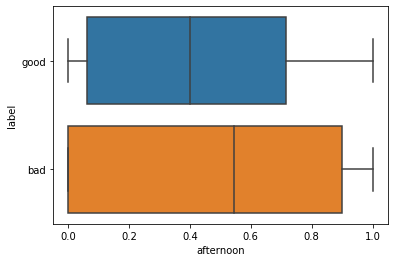

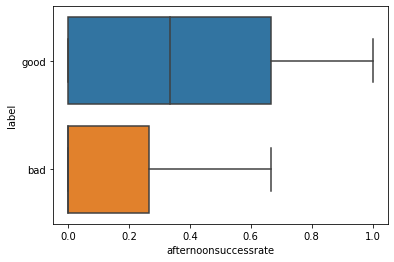

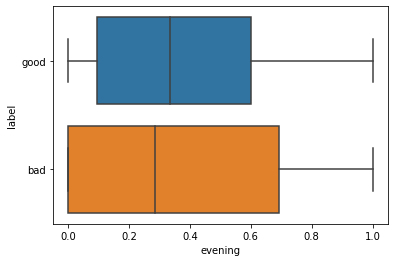

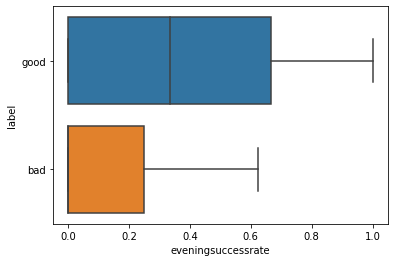

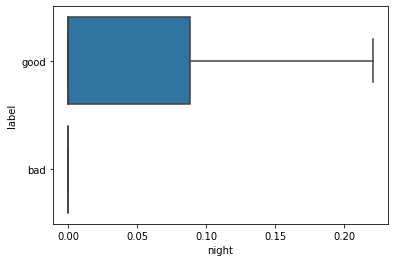

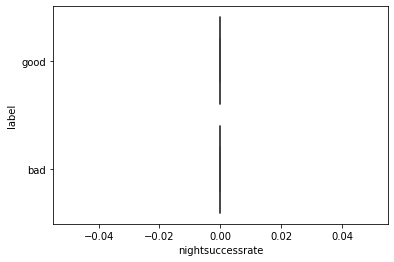

In [315]:
for i in ['morning','morningsuccessrate','afternoon','afternoonsuccessrate','evening','eveningsuccessrate','night','nightsuccessrate']:
    sns.boxplot(x=data[i],y=data['label'],data=data,showfliers=False)
    plt.show()

In [316]:
data['label'].value_counts()

good    869861
bad     120617
Name: label, dtype: int64

# switch to Untitled1

In [324]:
data['month']=data['date'].apply(lambda x:str(x)[:7])

In [326]:
data['month'].unique()

array(['2020-01', '2020-02', '2019-12', '2019-08', '2019-09', '2019-11',
       '2020-03', '2019-10', '2020-04', '2019-07'], dtype=object)

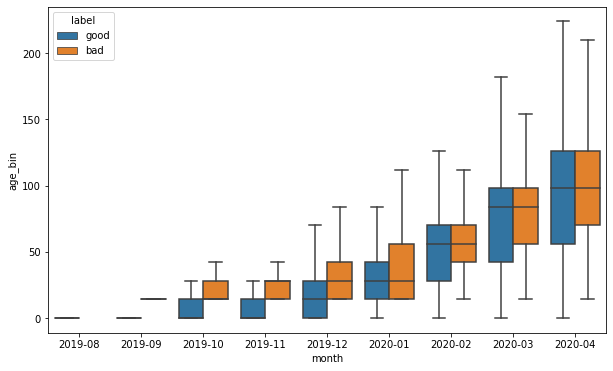

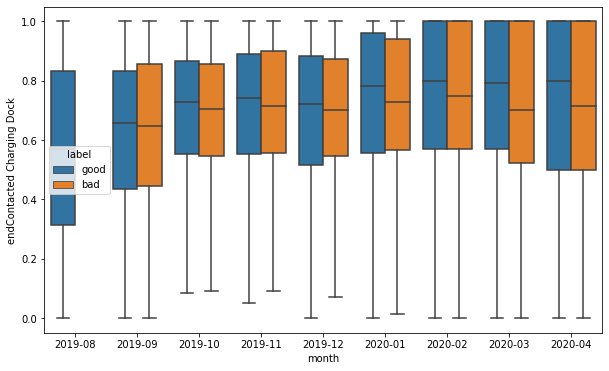

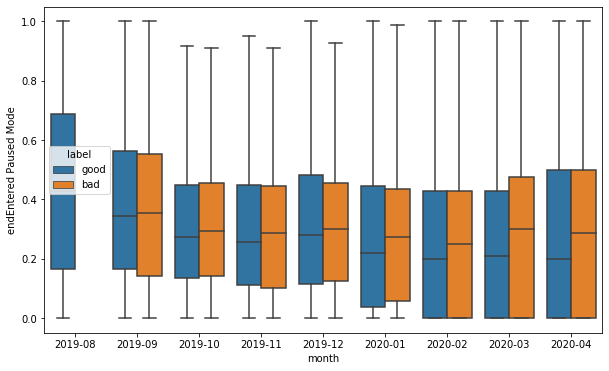

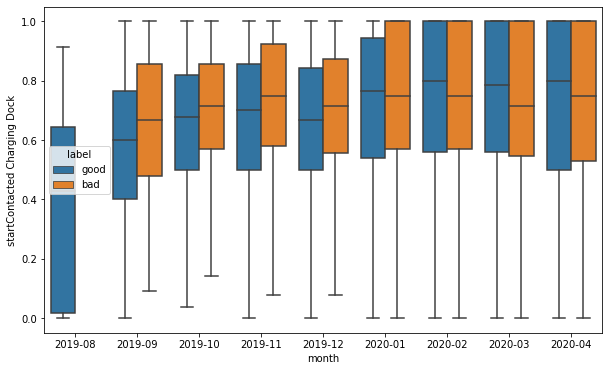

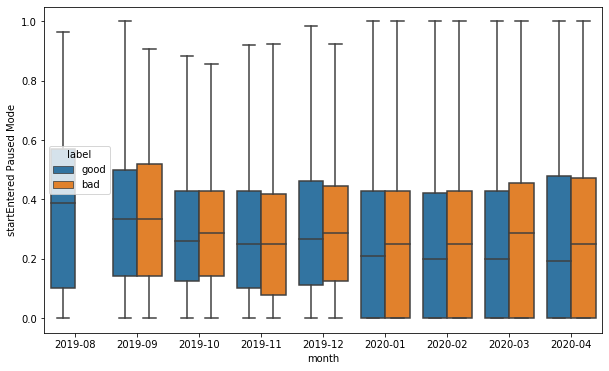

...

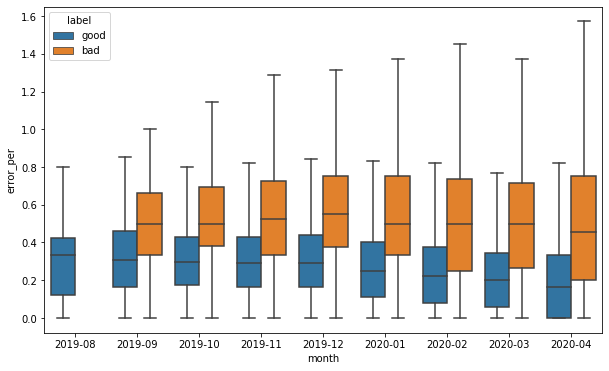

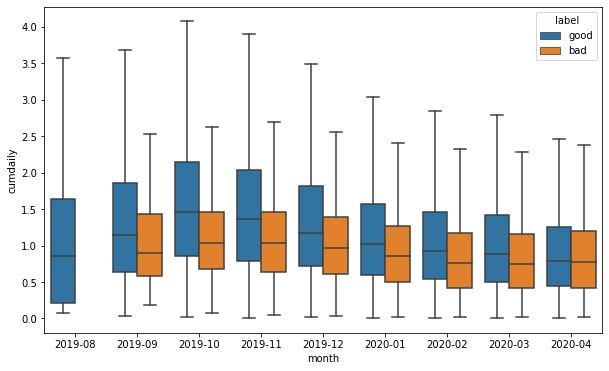

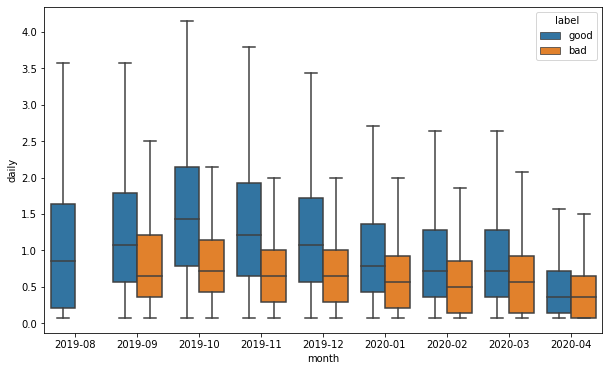

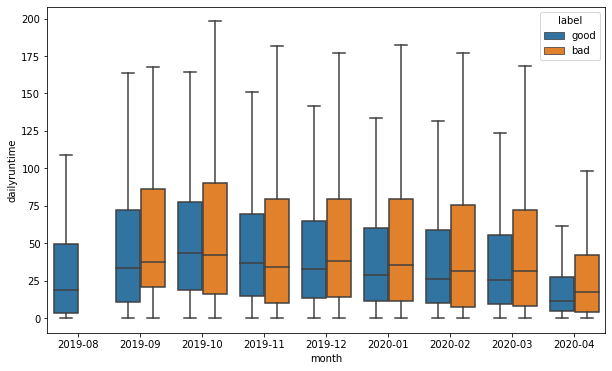

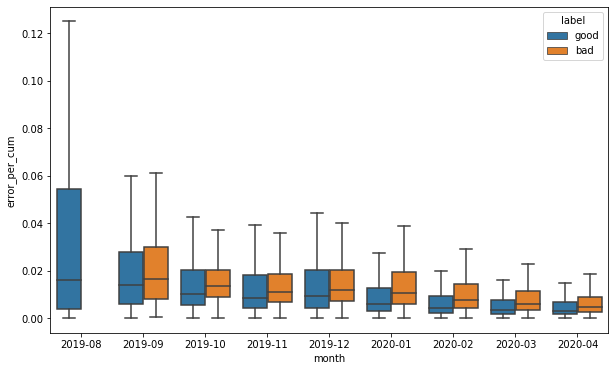

In [329]:
for i in skewlist[:]:
    plt.figure(figsize=(10,6))
    sns.boxplot(y=data[i],x=data['month'],hue=data['label'],data=data,showfliers=False,order=['2019-08', '2019-09','2019-10','2019-11','2019-12','2020-01', '2020-02', '2020-03',  '2020-04'])
    plt.show()

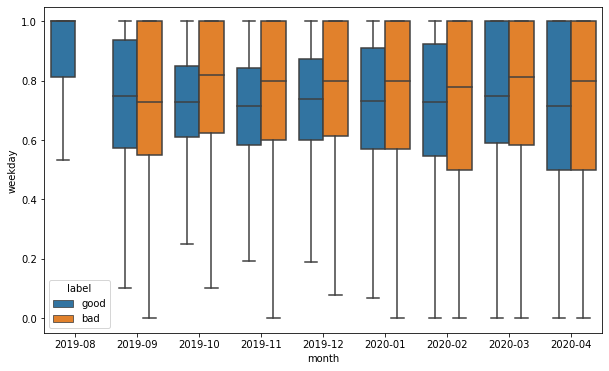

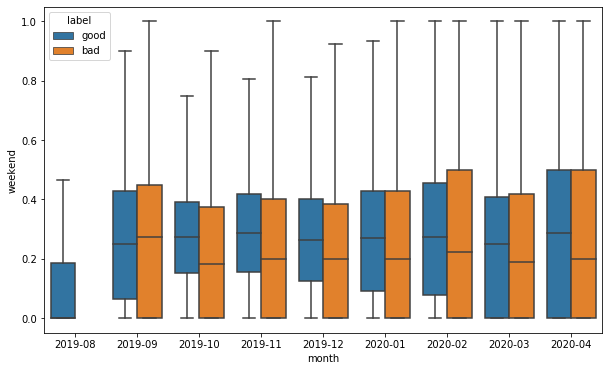

In [339]:
for i in ['weekday','weekend']:
    plt.figure(figsize=(10,6))
    sns.boxplot(y=data[i],x=data['month'],hue=data['label'],data=data,showfliers=False,order=['2019-08', '2019-09','2019-10','2019-11','2019-12','2020-01', '2020-02', '2020-03',  '2020-04'])
    plt.show()

In [340]:
data['DSN'].nunique()

166684

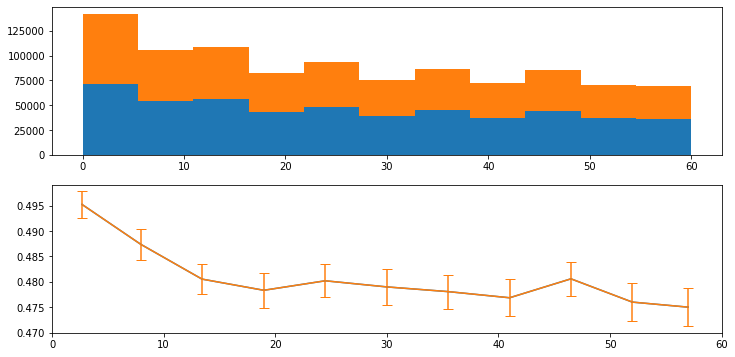

In [351]:
import ml_insights as mli
data['seconds']=data['date'].apply(lambda x:x[-2:]).map(int)
bins_1 = np.linspace(0,60,12)
#bins_2 = np.array()
#bins_final = np.unique(np.concatenate((bins_1, bins_2)))
mli.histogram_pair(data.seconds, data.successrate>0.45, bins=bins_1);

In [352]:
final_df

NameError: name 'final_df' is not defined

In [1]:
data['DSN'].nunique()

NameError: name 'data' is not defined

In [ ]:
for i in ['weekday','weekend']:
    plt.figure(figsize=(10,6))
    sns.boxplot(y=data[i],x=data['month'],hue=data['label'],data=data,showfliers=False,order=['2019-08', '2019-09','2019-10','2019-11','2019-12','2020-01', '2020-02', '2020-03',  '2020-04'])
    plt.show()

In [2]:
import csv

import pandas as pd
import numpy as np

chunk_list=[]
for chunk in pd.read_csv('./Downloads/All_mission_results.csv', chunksize=200000):
    chunk=chunk[[ 'CREATED_AT_REAL', 
        'OEM_MODEL', 'DSN', 'RUNS', 'LASTEVENT',
       'JOBSTART', 'JOB',  'ENTERED_DOCK_MODE',
       'CONTACTED_CHARGING_DOCK', 'GET_CLEANING_STATISTICS', 'RUNTIMECYCLE',
       'RUNTIMECUMULATIVE',  'TIME_TO_DOCK', 'PAUSE',
       'FIRSTEVENT','EVENTSEQ']]
    #chunk=clean(chunk)
    #chunk=chunk[chunk['OEM_MODEL'].isin(['RV1000','RV1000A'])]
    chunk['errors']=chunk['EVENTSEQ'].apply(lambda x:str(x).split(',').count('GET_Error_Code'))
    chunk['ENTERED_DOCK_MODE']=pd.to_datetime(chunk['ENTERED_DOCK_MODE'])
    chunk['CONTACTED_CHARGING_DOCK']=pd.to_datetime(chunk['CONTACTED_CHARGING_DOCK'])
    chunk['GET_CLEANING_STATISTICS']=pd.to_datetime(chunk['GET_CLEANING_STATISTICS'])
    chunk['RUNTIMECYCLE']=pd.to_datetime(chunk['RUNTIMECYCLE'])
    chunk['RUNTIMECUMULATIVE']=pd.to_datetime(chunk['RUNTIMECUMULATIVE'])
    
    chunk['JOBEND']=chunk[['ENTERED_DOCK_MODE','CONTACTED_CHARGING_DOCK', 'GET_CLEANING_STATISTICS', 'RUNTIMECYCLE',
    'RUNTIMECUMULATIVE']].min(axis=1)
    chunk=chunk.drop(['EVENTSEQ','ENTERED_DOCK_MODE',
       'CONTACTED_CHARGING_DOCK', 'GET_CLEANING_STATISTICS', 'RUNTIMECYCLE',
       'RUNTIMECUMULATIVE'],axis=1)
    
    chunk_list.append(chunk)

final_df = pd.concat(chunk_list)

KeyboardInterrupt: 

In [3]:
final_df

NameError: name 'final_df' is not defined

In [4]:
final_df=pd.read_csv('all_mission_results_rv.csv')

In [6]:
final_df.columns

Index(['CREATED_AT_REAL', 'OEM_MODEL', 'DSN', 'RUNS', 'LASTEVENT', 'JOBSTART',
       'JOB', 'TIME_TO_DOCK', 'PAUSE', 'FIRSTEVENT', 'errors', 'pause', 'dock',
       'JOBEND', 'age', 'age_bin', 'startfrom', 'weekday', 'hour', 'day',
       'job_end', 'tag', 'RUNTIME', 'suc'],
      dtype='object')

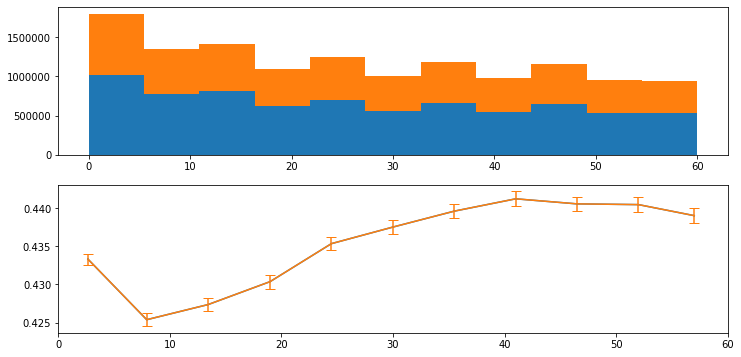

In [8]:
import ml_insights as mli
final_df['seconds']=final_df['CREATED_AT_REAL'].apply(lambda x:x[-2:]).map(int)
bins_1 = np.linspace(0,60,12)
#bins_2 = np.array()
#bins_final = np.unique(np.concatenate((bins_1, bins_2)))
mli.histogram_pair(final_df.seconds, final_df.suc==1, bins=bins_1);

In [11]:
import pandas as pd
data=pd.read_csv('./Auto_encoder/cluster_result.csv')

In [12]:
data['label']=np.where((data['kmeans']>=2)&(data['vae_kmeans_5']>=3)&(data['vae_kmeans_7']>=5)&(data['auto_encode']>=-0.6),'bad','good')

In [13]:
data['label'].value_counts()

good    869861
bad     120617
Name: label, dtype: int64

In [16]:
data.groupby(['label']).mean().T[:60]

label,bad,good
age_bin,60.564796,49.406330
endContacted Charging Dock,0.713347,0.721843
endEntered Paused Mode,0.286653,0.278157
startContacted Charging Dock,0.724574,0.708488
startEntered Paused Mode,0.275426,0.269552
jobs,8.803187,13.862315
max_runtime,257.869231,162.180428
min_runtime,22.002600,8.091521
mean_runtime,80.636204,43.152335
median_runtime,54.241463,32.680483


In [17]:
data.groupby(['label']).mean().T[60:120]

label,bad,good
evening_cum,0.396122,0.392956
counttime to dock_cum,0.694606,0.745667
countpause time_cum,0.709946,0.574162
weekend_cum,0.288005,0.302902
successjobs_cum,0.290279,0.425675
realsuccessjobs_cum,0.296109,0.435330
endContacted Charging Dock_rolling2,0.694983,0.593556
endEntered Paused Mode_rolling2,0.305017,0.214779
startContacted Charging Dock_rolling2,0.694095,0.591635
startEntered Paused Mode_rolling2,0.295657,0.210196
